# Pedestrian Detection in Images


- **All materials for this project (except for the dataset) must be located in the exact same directory.** It will be assumed that these files will be located in the same folder as the trained models, and all pictorial outputs will be written to the same directory.

- The paths to the dataset can be set in the first cell with the `IMAGE_PATH` and `LABEL_PATH` variables.

- The dataset used for this project can be accessed from this URL: 
https://drive.google.com/drive/folders/1p0JA4l4_9md_ycLLg_H2ColAozoz9ALt?usp=sharing . This folder is also the `data` folder of the above Google Drive account.

- The dataset folder structure must not be changed.

- A `requirements.txt` file should exist in the same folder as this notebook. `pip install -r requirements.txt` should satisfy the dependencies for this notebook.

---

References (including in the code) are notated in square brackets (e.g. `[6]`) throughout the notebook, with their full citations listed at the end.

## Introduction, Motivation, Problem Statement

The objective of this project is to detect pedestrians and cyclists in street and traffic settings, given in the form of images. This objective is a subset of the 'object detection' field of AI. The most obvious and common application of this lies within the field of self-driving / autonomous cars, and advanced car safety systems, but may also be similarly applied to other contexts such as foot traffic analysis, which can then be used for safety and security monitoring, city planning, or any other area where this information is useful. This project takes the perspective of an autonomous vehicle / advanced car safety system.

**Problem Statement:** A dynamic traffic setting poses many challenges for pedestrian detection - the environment is rapidly changing, and many variables need to be accounted for, such as weather conditions and day/night vision. The high-risk nature of this setting also means that accuracy and reasonable efficiency of pedestrian detection models must be a priority for safety. In this project we aim to apply, fine-tune, and evaluate several Faster R-CNN models, which given an image, return a bounding box for each identified pedestrian and cyclist.


This is a highly researched topic, and several models exist for this purpose. We chose to focus on Faster R-CNN models as most current research is centered around modifications and improvements to the Faster R-CNN architecture. As this is a popular topic, several datasets also exist for the purposes of pedestrian detection. Some target specific sub-problems, while others aim to maximise diversity and comprehensiveness.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Requirements
import os, sys, json, glob, random, time
import numpy as np
from tabulate import tabulate

import imageio as io
from PIL import Image
from IPython.display import display

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
matplotlib.rcParams['backend'] = "Qt4Agg"

import torch, torchvision
from torch.utils.data import Dataset
from torchvision import transforms
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator

!pip install geopandas
!pip install pygeos
from shapely.geometry import Polygon
import geopandas as gpd

# Global Variables
image_path = '/content/drive/MyDrive/data/Cityshapes_images/leftImg8bit/'
label_path = '/content/drive/MyDrive/data/CityPersons_labels/gtBboxCityPersons/'
project_path = '/content/drive/MyDrive/COMP9444_Project/'
image_ends = '_leftImg8bit.png'
label_ends = '_gtBboxCityPersons.json'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Data Sources

Because this is a heavily researched field, several popular datasets already exist, some of particular note listed below:

**EuroCity Persons Dataset:** `[10]` One of the largest and most comprehensive datasets currently is the EuroCities dataset. It contains 47,300 images in all seasons and weather conditions, in day and night time.

**WiderPerson Dataset:** `[11]` This is a dataset containing images of people in all contexts, not strictly pedestrians or traffic settings. This can be useful for the specific subtask of determining whether a person is a pedestrian or not (e.g. seated in a roadside cafe, etc.)

**PnPLO Dataset:** `[12]` This dataset is specifically contains images of "**P**eople a**n**d **P**eople-**L**ike-**O**bjects", i.e. objects that 'look' like humans, such as shop window mannequins, scarecrows, posters of people, etc. While it can be used for other tasks, it is still geared towards pedestrian detection, and is part of Karthika & Saravanan's Addressing False Positives in Pedestrian Detection (2020).

---

This project uses the CityPersons dataset `[13]`, which is a subset of the Cityscapes dataset `[9]` (available at https://www.cityscapes-dataset.com).

- For context, the Cityscapes dataset is a collection of images from 50 central European cities for the seasons spring, summer and autumn, during daytime in good or medium weather conditions. There are 30 annotation classes including cars, road, vegetation, sky etc. 5000 images have 'fine' pixel level semantic labeling and 20,000 images have a 'coarser' panoptic semantic labeling.

The CityPersons dataset was selected for this project due to its suitability in terms of comprehensiveness and manageable size (around 10GB). Several other data sources that were considered were either too limited in content, or too large (such as the EuroCity Persons Dataset).

The dataset contains 5005 images from 27 central European cities. Every image is exactly a 2048 x 1024 px,  3-channel (RGB) .PNG file with an 8-bit colour depth. The images in this dataset are from the spring, summer, and autumn seasons, and only during 'good - medium' weather. There are no night examples in this dataset. Objects of interest are labelled with a bounding box consisting of top-left coordinates, a width, height, and an assigned class.

Further explanations of classes and data splits are explained in the next section. Example instances of data are also shown and analysed in the next section.
The below code loads a function allowing us to see the images with their annotated bounding boxes and class labels.

In [ ]:
def show_image_with_labels(city_scene):
    with open(label_path + city_scene + label_ends) as file:
        label = json.load(file)
    annotation = label['objects']
    image = mpimg.imread(image_path+city_scene+image_ends)
    width, height = Image.open(image_path+city_scene+image_ends).size
    print(f"Image size: {width} x {height} pixels")
    
    fig, ax = plt.subplots(figsize=(12,7))
    ax.imshow(image)
    for obj in annotation:
        rect = patches.Rectangle((obj['bbox'][0], obj['bbox'][1]), obj['bbox'][2], obj['bbox'][3], linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        ax.text(obj['bbox'][0], obj['bbox'][1], obj['label'], color='yellow') 
    plt.show()

## Exploratory Analysis of Data

There are 6 classes in the dataset: "ignore", "pedestrian", "rider", "sitting person", "person (group)", and "person (other)". For our purposes, we do not consider the last 3 classes in this list:

- "Pedestrian" refers to any human walking or standing within the image (as all images are assumed to be taken from the road).

- "Rider" refers to any human with one leg on each side of their bicycle. (If a person is 'walking' their bicycle, i.e. with both legs on one side of the bicycle, they are considered a "pedestrian").

- The other three classes are reserved for people who are not pedestrians (e.g. those sitting in roadside cafes, bus stop benches, etc.). We do not consider these classes because they are not specifically relevant to our objective. From the perspective of a self-driving car, not every person is a pedestrian, but those who are pedestrians are what pose the highest risk. Additionally, after experimentation it was determined that there was too much variance and too little data for these classes to be useful.

Recall there are a total of 5005 images in the dataset. Of the 3475 labelled images in the dataset, 2975 are designated for training, and 500 are designated for validation. The remaining 1530 images are unlabelled and are designated for testing purposes. For training, validation, and testing, images from different cities are used.

For the purposes of objective comparison between the modifications we made to the models in this notebook, we re-split the distribution of labelled images in order to be able to quantify accuracies with labelled data. For this project, we used 2890 training images, 352 validation images, and 233 labelled test images (with which we can measure the accuracy of each trained model), leaving the original 1530 unlabelled test images available for any visual comparisons we would like to make.

The below cells show examples from the dataset. A summary of challenges are listed here:
- The visibility of certain figures are lowered by a high degree of shadowing.
- Billboards and advertisements containing images of people risk raising a false positive result.
- Not every image contains a pedestrian, and bicycles without their riders should not be detected as "riders".
- A person who is walking with their bicycle (but not riding it) should be classified as a pedestrian.
- It can be seen that all of the images were taken from the dashboard of a Mercedes Benz vehicle. The presence of the hood ornament should not be an issue, however it must be considered when evaluating results.

Some shortcomings of the dataset include:
- There are no winter examples, 'bad' weather examples, or samples taken during night time.
- There are limited "ignore" (false positive) examples.
- There is limited handling of non-pedestrian people (hence why we ignore those classes in this project)

These issues can be resolved in the future by using some additional data (resources permitting), such as some subsets of the aforementioned other datasets. For examples, *EuroCities* can provide more diverse weather and night examples, *WiderPerson* can assist in improving the handling of non-pedestrian people, and *PnPLO* is specifically geared towards what we currently call the "ignore" class.

### Data Examples

Image size: 2048 x 1024 pixels


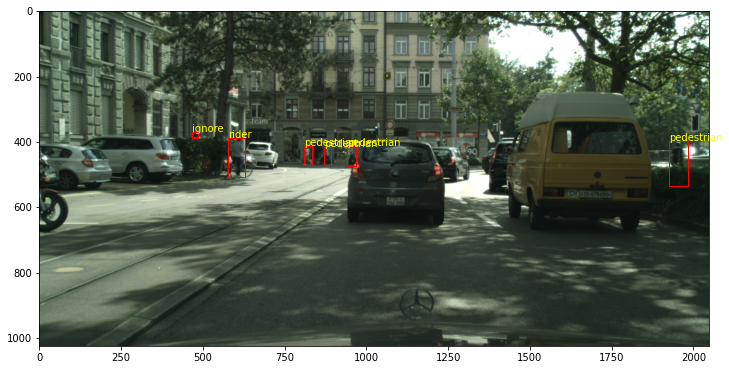

In [ ]:
show_image_with_labels('train/zurich/zurich_000005_000019')

The difficulty of visibility can be observed from this example. It is difficult to differentiate between riders and pedestrians, and in some cases, pedestrians blend very easily into shadows, making it difficult for the model to find features.

Image size: 2048 x 1024 pixels


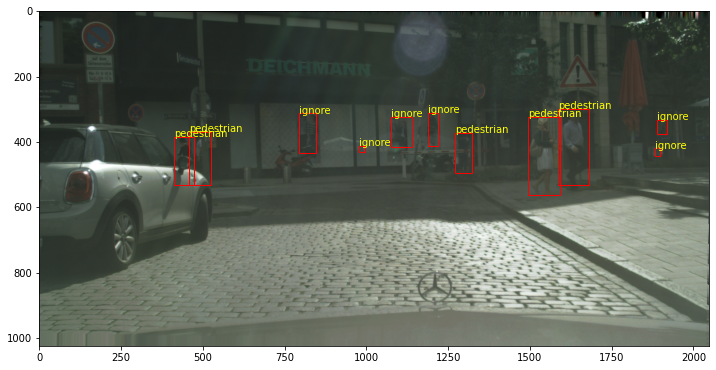

In [ ]:
show_image_with_labels('train/hamburg/hamburg_000000_032719')

The model should also be able to distinguish between people and pictures of people, or any other "human-like" objects.
Reflections from the sun can reduce visibility in images.

Image size: 2048 x 1024 pixels


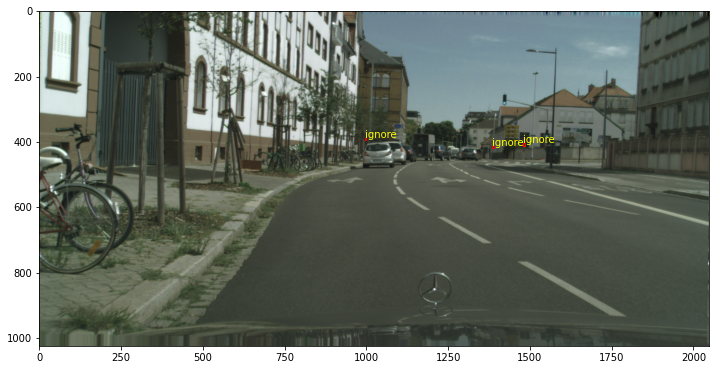

In [ ]:
show_image_with_labels('train/strasbourg/strasbourg_000000_002183')

There are not always pedestrians in the data as we can see in the image above. Bicycles without their 'riders' should not be detected by the model.

### Data Loading

The code below `[15]` loads the dataset for use with the rest of the code. This also filters out all bounding boxes that are not required for our purpose - we are considering "pedestrian" and "rider" classes from the data only.

In [ ]:
# REF: [15]

def label_class(s):
    if s == 'pedestrian':
        return 1
    elif s == 'rider':
        return 2
    else:
        return None

def class_label(n):
    if n == 1:
        return "pedestrian"
    elif n == 2:
        return "rider"
    else:
        return ""
 
class CityPersonsDataset(Dataset):
    def __init__(self, mode, transform=None):
        self.mode = mode 
        self.transform = transform
        self.dataset = glob.glob(f"{label_path}{mode}/*/*.json")

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        with open(self.dataset[idx]) as file:
            label = json.load(file)
        img_name = self.dataset[idx].replace('CityPersons_labels/gtBboxCityPersons','Cityshapes_images/leftImg8bit')
        img_path = img_name.replace('gtBboxCityPersons.json','leftImg8bit.png')
        image = Image.open(img_path).convert("RGB")
        transform = transforms.Compose([transforms.ToTensor()])
        image = transform(image)
        
        boxes = []
        labels = []
        for o in label['objects']:
            if o['label'] in ['pedestrian', 'rider']:
                # xmin, ymin,  xmax, ymax
                boxes.append([o['bbox'][0], o['bbox'][1], o['bbox'][0] + o['bbox'][2], o['bbox'][1] + o['bbox'][3]])
                labels.append(label_class(o['label']))

        if len(boxes) == 0:
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros(0, dtype=torch.int64)
        else:
            boxes = torch.as_tensor(boxes, dtype=torch.float32)
            labels = torch.as_tensor(labels, dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        return image, target

train_loader = torch.utils.data.DataLoader(CityPersonsDataset('train'), batch_size=2, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
valid_loader = torch.utils.data.DataLoader(CityPersonsDataset('val'), batch_size=2, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

## Models and Results

### Introduction to Models

In researching the topic of pedestrian detection and the numerous models that exist, the Faster-RCNN was deemed to be the most fitting model for the task, and the main focus of our experimentation. This was largely due to the higher degree of accuracy it has over some state-of-the-art models for object detection such as SSD, YOLOv5, RetinaNet, etc. While these aforementioned models are categorised as single-stage detectors, Faster-RCNN is a two-stage detection method. Despite these single-stage methods having a faster prediction speed, the two-stage architecture of the Faster-RCNN, consisting of a Region Proposal Network (RPN) and a Fast-RCNN to detect objects in said regions, allows for better recognition accuracy, making it more ideal for our objective. 

Even with a slower inference speed, Faster-RCNN is still faster than its predecessors RCNN and Fast-RCNN due its use of an RPN for proposing regions rather than the much slower Selective Search algorithm, that was previously used. 

And while other two-stage methods exist, such as Mask-RCNN, they extend upon the Faster-RCNN but do not necessarily fix any prominent/existing issues with the Faster-RCNN. For example, Mask-RCNN also produces an object mask for each object, along with labels and bounding boxes, however, this is not crucial or necessary to our task, thus, making Faster-RCNN the more suitable choice. 

In our training of the Faster-RCNNs, we used different versions of two backbones:

*   MobileNet
*   ResNet50 

We present each model in the order in which we experimented with them. We assigned internal names for each of them for organisational reasons. This table clarifies what each internal name is referring to:

| Internal Model Name | Model                                   |
|---------------------|-----------------------------------------|
| frcnn1              | Faster RCNN with MobileNet v2           |
| frcnn2              | Faster RCNN with ResNet50 FPN           |
| frcnn3              | Faster RCNN with ResNet50 FPN v2        |
| frcnn4              | Faster RCNN with MobileNet v3 Large FPN |


The results of each model are provided within their respective subsections. We used average overlap accuracy, average miss rate `(false negatives / (true positives + false negatives)` and average inference speed in order to measure and compare the models, as these were the most relevant to our objective.

**References:** `[1]`, `[6]`, `[7]`, `[8]`



In [ ]:
# REF: [16], [17], [18], [19], [20]

def model_chooser(name):
    if name == "frcnn1":
        backbone = torchvision.models.mobilenet_v2(weights="DEFAULT").features
        backbone.out_channels = 1280
        anchor_generator = AnchorGenerator(sizes=((32, 64, 128, 256, 512),),aspect_ratios=((0.5, 1.0, 2.0),))
        roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'],output_size=7,sampling_ratio=2)
        model = FasterRCNN(backbone,num_classes=3,rpn_anchor_generator=anchor_generator,box_roi_pool=roi_pooler)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.002, momentum=0.9)

    elif name == "frcnn1b":
        backbone = torchvision.models.mobilenet_v2().features
        backbone.out_channels = 1280
        anchor_generator = AnchorGenerator(sizes=((32, 64, 128, 256, 512),),aspect_ratios=((0.5, 1.0, 2.0),))
        roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=['0'],output_size=7,sampling_ratio=2)
        model = FasterRCNN(backbone,num_classes=3,rpn_anchor_generator=anchor_generator,box_roi_pool=roi_pooler)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.002, momentum=0.9)

    elif name == "frcnn2":
        model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.001, momentum=0.9)

    elif name == "frcnn2b":
        model = torchvision.models.detection.fasterrcnn_resnet50_fpn()
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.001, momentum=0.9)

    elif name == "frcnn3":
        model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(weights="DEFAULT")
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.001, weight_decay=0.01, momentum=0.9)

    elif name == "frcnn3b":
        model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2()
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.001, weight_decay=0.01, momentum=0.9)

    elif name == "frcnn4":
        model = torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn(weights="DEFAULT")
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.002, momentum=0.9)

    elif name == "frcnn4b":
        model = torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn()
        in_features = model.roi_heads.box_predictor.cls_score.in_features
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, 3)
        optimiser = torch.optim.SGD(model.parameters(), lr=0.002, weight_decay=0.002, momentum=0.9)

    return (model, optimiser)

### Training

During experimentation, we discovered this task has high GPU requirements. To accomodate this, we trained our models locally (with the following code). The trained models were then re-uploaded and loaded for use with the test set of data. The process and hyperparameters for each model's creation are outlined within each model's dedicated section. Hyperparameters were determined for all models through trial-and-error experimentation and observing the average training and validation losses/errors over each epoch. The original value for both the learning rate and weight decay was 0.005 and adjusted accordingly. As the half of the demonstrated models make use of pretrained weights from the PyTorch library, only smaller increments needed to be made in order to train the models on the dataset. Stochastic Gradient Descent was used on every model with a momentum of 0.9.

**GPU:** NVIDIA TU116M (GeForce GTX 1660 Ti Mobile 6GB)

**Batch Size:** Due to computational resource limitations, a batch size of 3 or higher was not possible, so all networks were trained with a batch size of 2.

**Epochs:** Each network was trained with 10 epochs.

**Confidence Threshold:** Through experimentation, we determined 0.66 to be the confidence threshold over which we can consider an object as detected with its class. This was determined through visual observation - many bounding boxes proposed below this confidence threshold were false positives.

The saved model names were labelled for convenience, only for internal use with the code in this notebook.



The following code `[4]`, `[5]`, `[14]` has been provided in markdown instead of a code cell to prevent accidental running, retraining, and overwriting of the already trained models that the rest of this notebook relies on. It shows the training process only and can be re-run by manually copying it into a new code cell.

```
# REF: [4], [5], [14]

model_name = "example_model"
model, optimiser = model_chooser(model_name)

model.to(DEVICE)
num_epochs = 10
train_stats = []
valid_stats = []

for epoch in range(num_epochs):
    train_stats.append([])
    valid_stats.append([])
    #train
    for i, (images,targets) in enumerate(train_loader):  
        optimiser.zero_grad()
        images = list(image.to(DEVICE) for image in images)
        targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        losses.backward()
        optimiser.step()
        print(f'Training: Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_loader)}], Loss: {loss_value:.4f}')
        train_stats[epoch].append(loss_value)
    #validate
    for i, (images,targets) in enumerate(valid_loader):  
        images = list(image.to(DEVICE) for image in images)
        targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]
        with torch.no_grad():
            loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        print(f'Validating: Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(valid_loader)}], Loss: {loss_value:.4f}')
        valid_stats[epoch].append(loss_value)

torch.save(model.state_dict(), project_path + 'saved_model.pth')

# Plot Statistics (Average Loss per Epoch)
plt.figure(figsize=(8,5))
x = [i for i in range(1, num_epochs+1)]
y1 = [sum(l) / len(l) for l in train_stats]
y2 = [sum(l) / len(l) for l in valid_stats]
plt.title("Loss throughout Training and Validation")
plt.ylim(0,0.8)
plt.plot(x, y1, label="Training")
plt.plot(x, y2, label="Validation")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.savefig(f"{model_name}_loss.png",format='png')
```


### Testing

The below code allows us to easily test each model on a couple of images. The first image is a manually preselected image that contains a large number of pedestrians and riders to be detected, in both foreground and background. The second image is chosen randomly from all of the unlabelled test images.

In [ ]:
def test_model(name):
    model, _ = model_chooser(name)
    model.load_state_dict(torch.load(project_path + f"{name}.pth", map_location=device))
    model.to(device)

    ALL_TEST_IMAGES = glob.glob(image_path + "unlabelled_test/*/*.png")
    TWO_TEST_IMAGES = [image_path + "unlabelled_test/munich/munich_000334_000019_leftImg8bit.png",
                       random.choice(ALL_TEST_IMAGES)]

    model.eval()
    for i, f in enumerate(TWO_TEST_IMAGES):
        image = Image.open(f).convert("RGB")
        transform = transforms.Compose([transforms.ToTensor()])
        image = transform(image).to(device)
        with torch.no_grad():
            p = model([image])
            im = mpimg.imread(f)
            fig, ax = plt.subplots(figsize=(16,9))
            ax.imshow(im)
            table_data = []
            print(f"Test Image Filename: {os.path.basename(f)}")
            for j, bbox in enumerate(p[0]["boxes"]):
                a, b, c, d = bbox[0].item(), bbox[1].item(), bbox[2].item(), bbox[3].item()
                if p[0]["scores"][j] > 0.66:
                    rect = patches.Rectangle((a, b), c-a, d-b, linewidth=1, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    cls = p[0]["labels"][j].item()
                    ax.text(a, b, class_label(cls), color='yellow', fontsize='x-large')
                    table_data.append([j, a, b, c, d, p[0]['scores'][j].item(), cls, class_label(cls)])
            print(tabulate(table_data, headers=[" ", "xmin", "ymin", "xmax", "ymax", "confidence", "class", "label"]), "\n")
            plt.show()

### A Glance at YOLOv5 Results

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-11-16 Python-3.7.15 torch-1.12.1+cu113 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 
image 1/1: 1024x2048 4 persons
Speed: 114.3ms pre-process, 221.4ms inference, 1.1ms NMS per image at shape (1, 3, 320, 640)


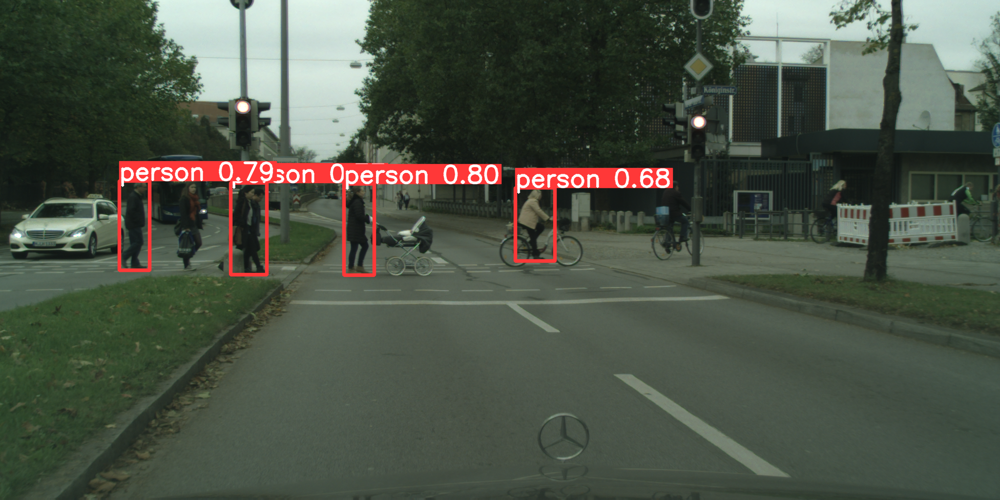

,xmin,ymin,xmax,ymax,confidence,class,name
0,704.412537,376.290771,766.842834,563.106384,0.804387,0,person
1,244.029022,370.095093,306.713684,553.553833,0.791111,0,person
2,472.452881,374.548462,546.414978,562.203552,0.767842,0,person
3,1055.940308,384.388641,1136.204346,534.758057,0.676364,0,person


In [ ]:
# REF: [21]

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
# Filter classes to relevant ones specific to our objective
model.classes = [0] # 0 = person, according to the COCO format used by the yolov5 model
model.conf = 0.66 # confidence level threshold
# Example image
imgs = Image.open(image_path + 'unlabelled_test/munich/munich_000334_000019_leftImg8bit.png')
# Inference
results = model(imgs)
# Results
results.print()
results.show()  # or .save()
results.xyxy[0]  # img1 predictions (tensor)
results.pandas().xyxy[0]  # img1 predictions (pandas)

### 1: Faster RCNN with MobileNet v2 Backbone

- Learning Rate: 0.002
- Weight Decay: 0.002
- Time to Train: ~ 99 min, 52 sec
- Saved Model Name: frcnn1 (default weights), frcnn1b (without default weights)
- Number of Parameters: 170

In [ ]:
model, _ = model_chooser("frcnn1")
print(model)
print(f"Number of Parameters: {len(list(model.parameters()))}")

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidu

#### With Default Weights

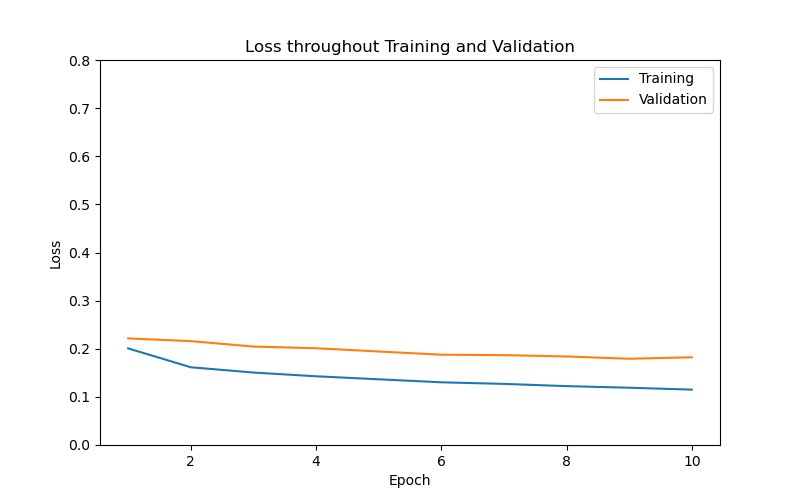

In [ ]:
display(Image.open(project_path + "frcnn1_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   696.016  376.632   768.287  554.018      0.988387        1  pedestrian
  1   248.838  367.628   321.664  545.775      0.984576        1  pedestrian
  2   472.443  380.386   545.418  544.839      0.983033        1  pedestrian
  3  1062.37   388.554  1122.14   527.409      0.960327        2  rider
  4  1363.33   370.32   1413.59   507.201      0.947136        2  rider
  5  1696.63   361.674  1746.22   489.013      0.919595        1  pedestrian
  6   365.775  369.354   424.345  509.508      0.917479        2  rider
  7  1955.56   362.477  2012.54   497.413      0.818327        1  pedestrian
  8  1085.15   397.624  1142.9    523.182      0.784668        2  rider
  9   499.374  381.493   566.874  530.618      0.689537        1  pedestrian
 10   228.735  378.877   295.732  544.679  

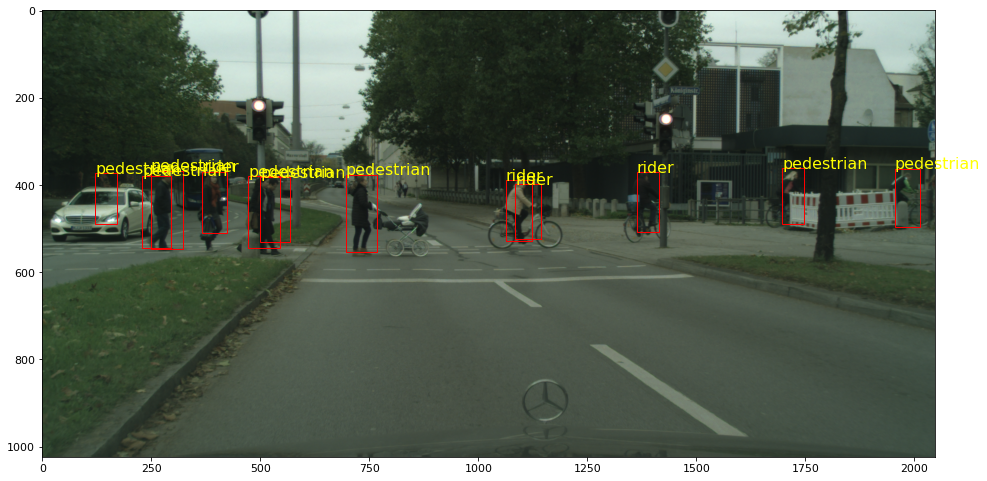

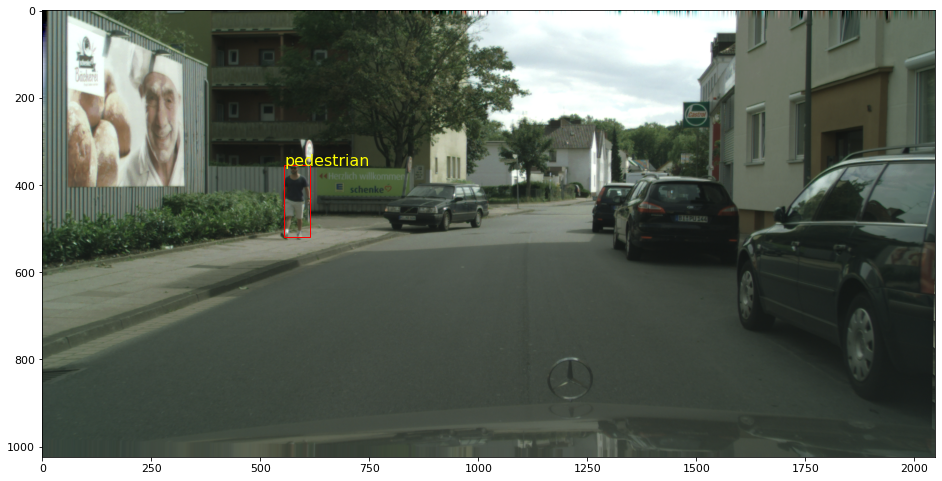

In [ ]:
test_model("frcnn1")

#### Without Default Weights

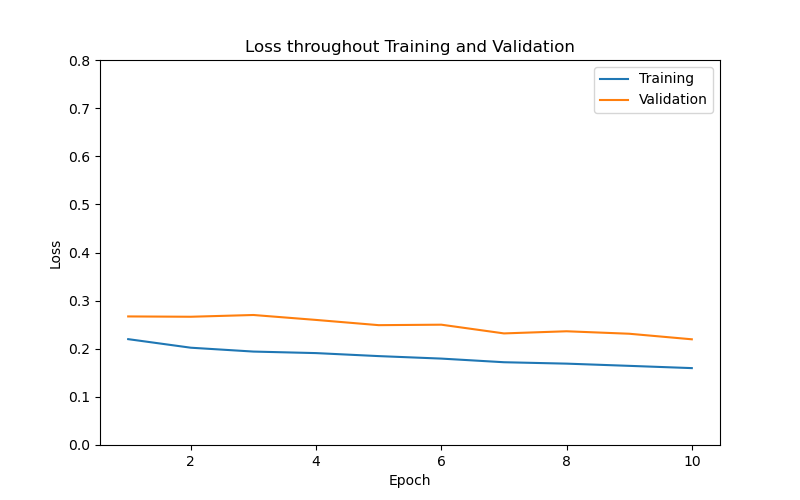

In [ ]:
display(Image.open(project_path + "frcnn1b_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   479.543  368.633   555.912  552.199      0.897013        1  pedestrian
  1   363.027  370.16    436.272  550.623      0.866158        1  pedestrian
  2  1353.19   379.458  1415.24   531.607      0.828619        1  pedestrian
  3  1058.01   393.615  1119.52   545.83       0.759895        1  pedestrian 

Test Image Filename: berlin_000103_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   859.359  392.987   890.491  528.114      0.906811        1  pedestrian
  1  1158.76   380.18   1218.56   532.029      0.897056        1  pedestrian
  2  1802.36   393.897  1862.58   542.935      0.895819        1  pedestrian
  3   864.782  391.474   918.456  528.219    

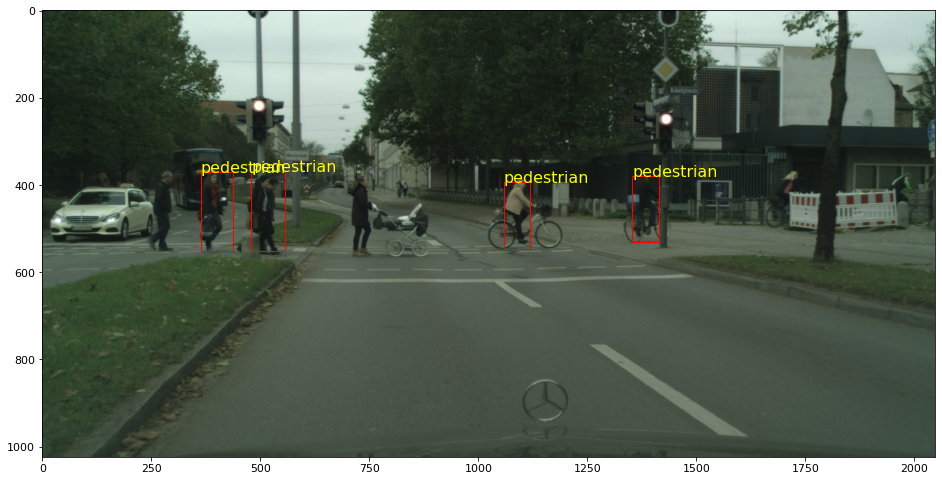

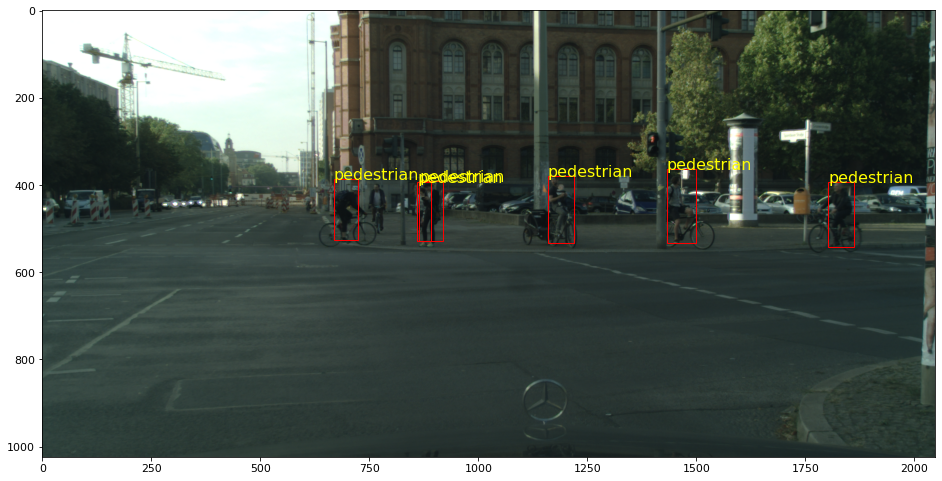

In [ ]:
test_model("frcnn1b")


### 2: Faster RCNN ResNet50 FPN

- Learning Rate: 0.002
- Weight Decay: 0.001
- Time to Train: ~ 123 min, 14 sec
- Saved Model Name: frcnn2 (default weights), frcnn2b (without default weights)
- Number of Parameters: 83

In [ ]:
model, _ = model_chooser("frcnn2")
print(model)
print(f"Number of Parameters: {len(list(model.parameters()))}")

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

#### With Default Weights

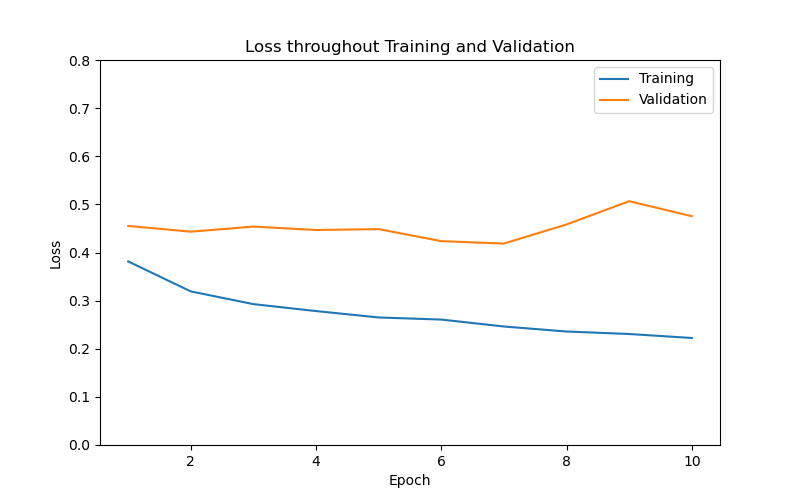

In [ ]:
display(Image.open(project_path + "frcnn2_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   243.635  368.693   316.571  547.536      0.999185        1  pedestrian
  1   696.356  378.926   770.102  558.084      0.998566        1  pedestrian
  2   487.935  382.508   558.899  558.651      0.998179        1  pedestrian
  3  1069.64   392.006  1124.08   526.299      0.997766        2  rider
  4   353.967  372.441   425.151  547.53       0.996928        1  pedestrian
  5  1356.27   371.463  1410.33   503.55       0.988741        2  rider
  6   824.36   390.377   841.039  430.682      0.976158        1  pedestrian
  7   468.208  381.896   534.118  553.632      0.94482         1  pedestrian
  8   811.34   391.558   826.495  430.41       0.897943        1  pedestrian
  9   121.549  369.677   159.5    468.048      0.8507          1  pedestrian
 10   816.029  391.054   831.936 

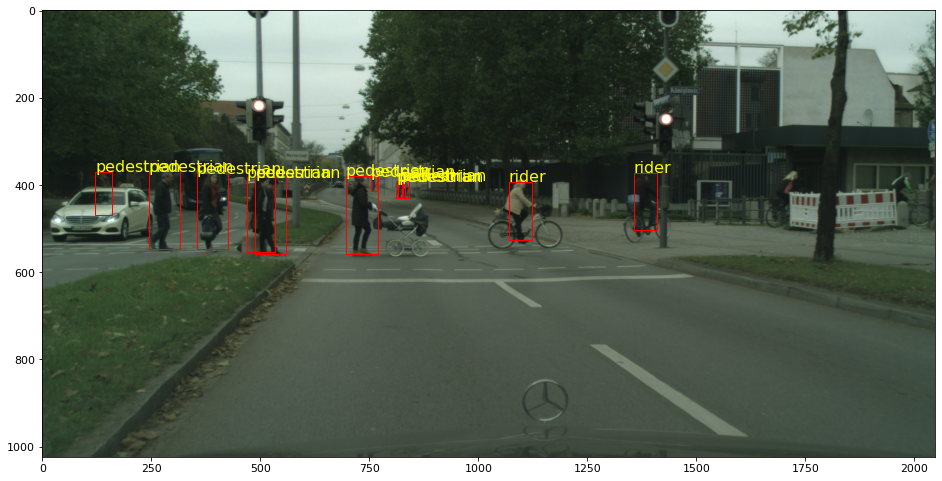

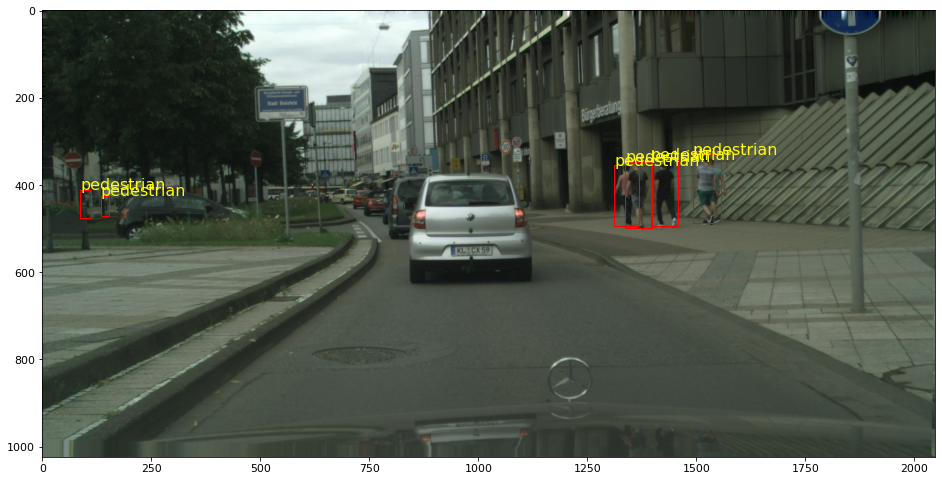

In [ ]:
test_model("frcnn2")

#### Without Default Weights

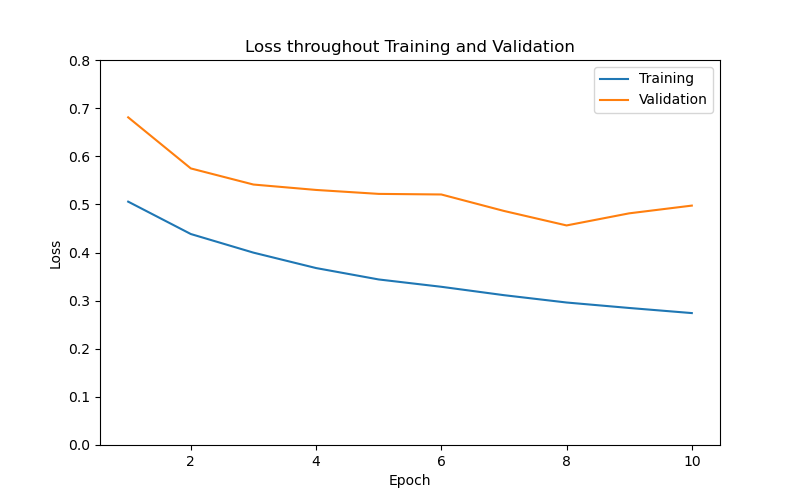

In [ ]:
display(Image.open(project_path + "frcnn2b_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   692.308  380.217   767.882  561.394      0.998264        1  pedestrian
  1   477.103  384.372   551.669  562.637      0.997459        1  pedestrian
  2  1067.4    380.604  1126.01   528.222      0.996727        2  rider
  3   242.278  374.508   315.284  550.75       0.996407        1  pedestrian
  4   349.474  365.015   427.02   553.115      0.993208        1  pedestrian
  5  1355.34   372.995  1407.79   501.223      0.982562        2  rider
  6  1694.35   372.687  1745.91   485.103      0.951709        1  pedestrian
  7  1959.65   373.93   2005.84   484.3        0.927984        1  pedestrian
  8   822.771  389.865   838.88   429.39       0.908746        1  pedestrian
  9   812.528  390.035   828.556  429.188      0.864293        1  pedestrian
 10   125.207  371.652   157.216 

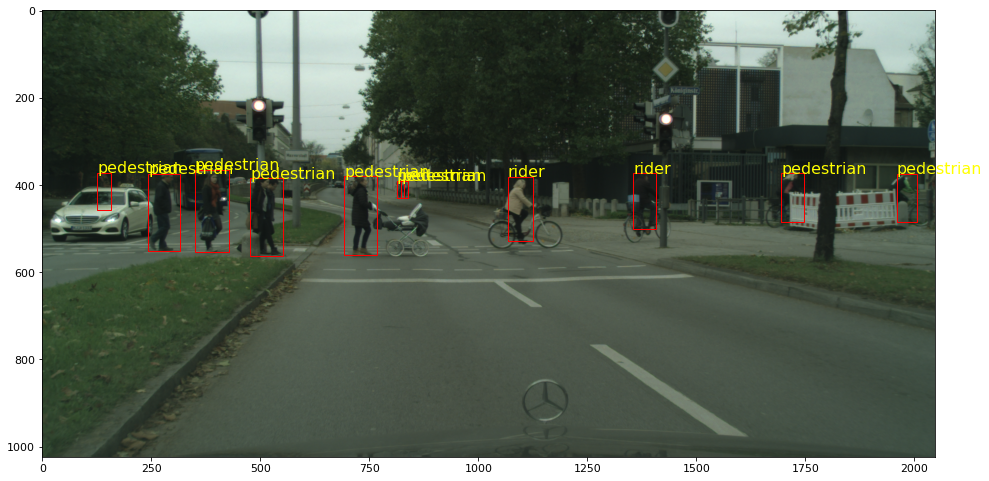

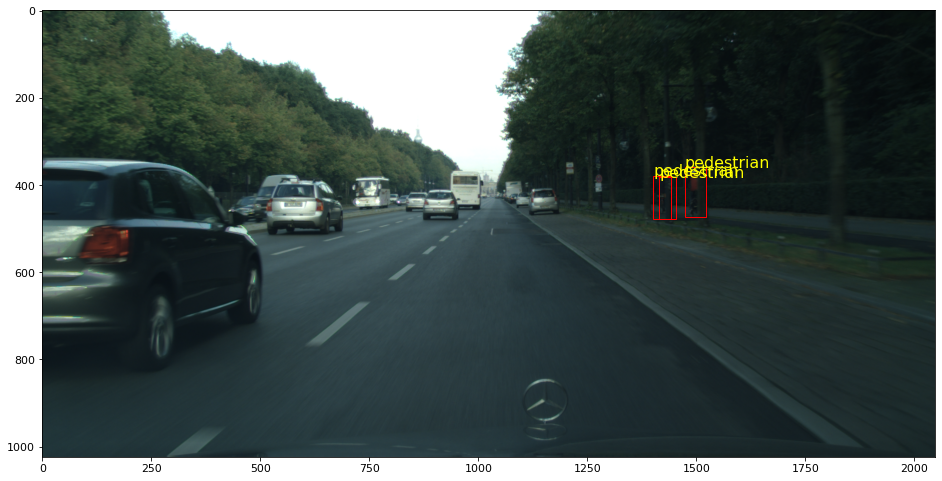

In [ ]:
test_model("frcnn2b")

### 3: Faster RCNN ResNet 50 FPN v2

- Learning Rate: 0.001
- Weight Decay: 0.01
- Time to Train: ~ 172 min, 1 sec
- Saved Model Name: frcnn3 (default weights), frcnn3b (without default weights)
- Number of Parameters: 209

In [ ]:
model, _ = model_chooser("frcnn3")
print(model)
print(f"Number of Parameters: {len(list(model.parameters()))}")

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

#### With Default Weights

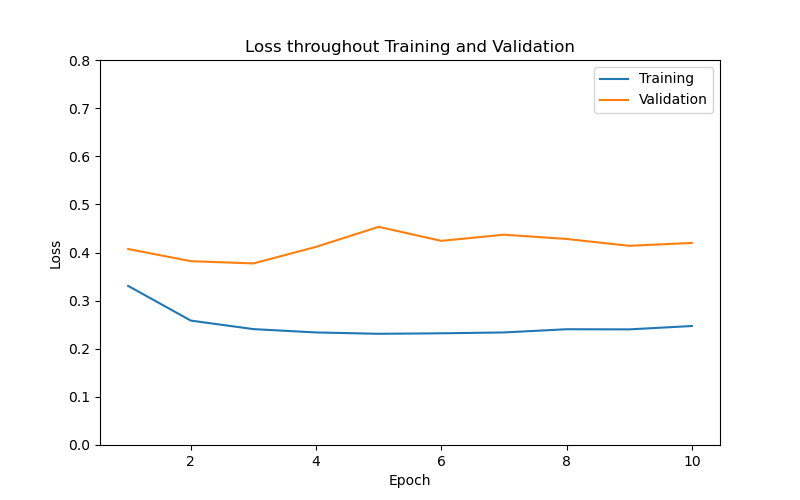

In [ ]:
display(Image.open(project_path + "frcnn3_loss.png"))

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth


  0%|          | 0.00/167M [00:00<?, ?B/s]

Test Image Filename: munich_000334_000019_leftImg8bit.png
          xmin     ymin      xmax     ymax    confidence    class  label
---  ---------  -------  --------  -------  ------------  -------  ----------
  0   244.755   366.182   318.689  550.808      0.99329         1  pedestrian
  1   698.212   378.631   771.955  558.674      0.993281        1  pedestrian
  2   479.736   380.525   553.068  561.129      0.992416        1  pedestrian
  3  1069.13    389.474  1126.66   524.041      0.990356        2  rider
  4   825.535   391.216   841.441  430.503      0.983858        1  pedestrian
  5  1354.61    370.978  1409.37   502.947      0.97896         2  rider
  6   811.96    390.764   828.743  431.805      0.967185        1  pedestrian
  7   355.463   373.077   420.556  546.055      0.958999        1  pedestrian
  8   120.118   373.316   159.353  479.531      0.902104        1  pedestrian
  9    64.9996  368.002   108.527  487.115      0.730835        1  pedestrian 



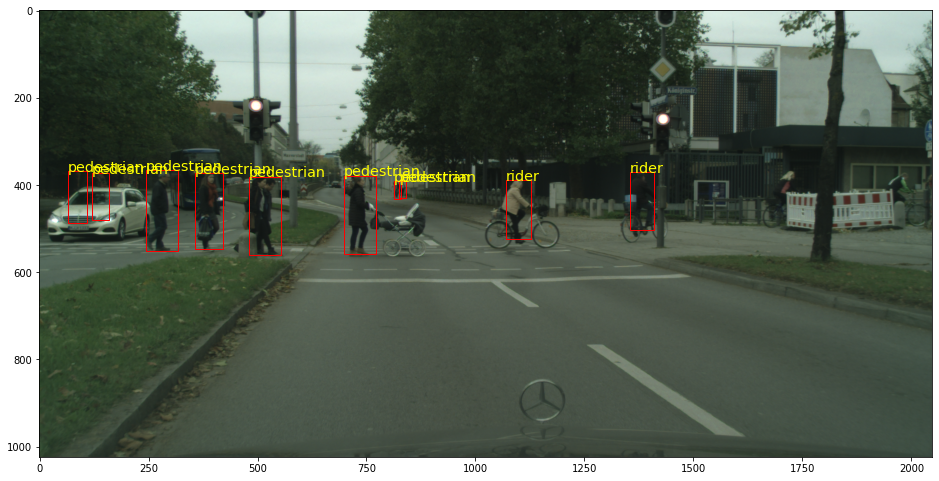

Test Image Filename: berlin_000455_000019_leftImg8bit.png
        xmin     ymin     xmax     ymax    confidence    class  label
---  -------  -------  -------  -------  ------------  -------  ----------
  0  1404.27  402.544  1432.65  472.829      0.990894        1  pedestrian
  1  1628.65  378.893  1662.37  462.226      0.988662        1  pedestrian
  2  1567.86  389.729  1597.6   464.726      0.988552        1  pedestrian
  3  1346.14  399.401  1380.9   480.652      0.987047        1  pedestrian
  4  1605.93  380.867  1639.5   467.958      0.985701        1  pedestrian
  5  1716.64  379.59   1753.03  470.26       0.984132        1  pedestrian
  6  1302.14  411.121  1327.76  475.513      0.983692        1  pedestrian
  7  1588.98  380.317  1621.82  464.803      0.974137        1  pedestrian
  8  1380.77  399.186  1413.22  481.461      0.962205        1  pedestrian
  9  1394.76  400.732  1423.8   474.022      0.949236        1  pedestrian
 10  1274.41  414.932  1296.35  469.261      0.

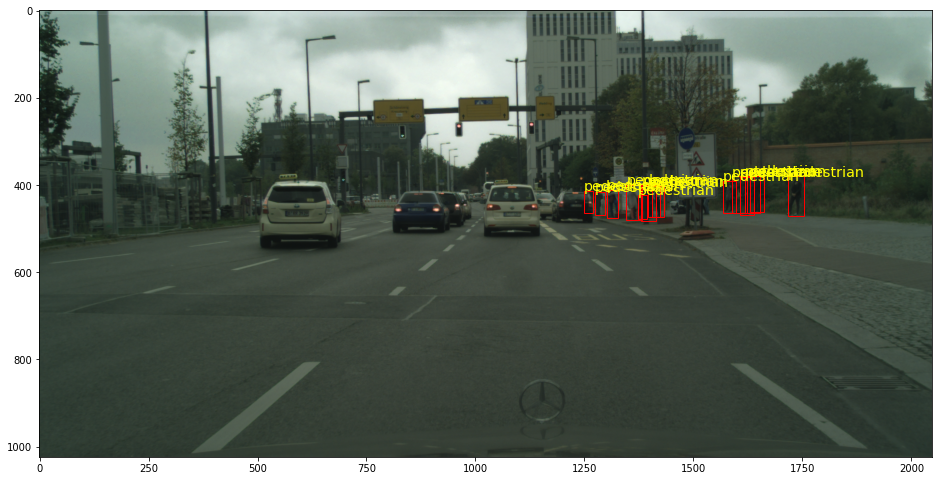

In [ ]:
test_model("frcnn3")

#### Without Default Weights

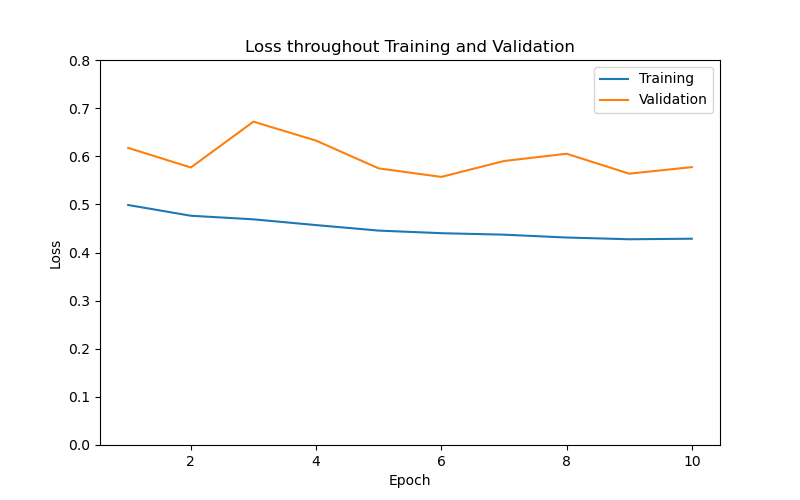

In [ ]:
display(Image.open(project_path + "frcnn3b_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   694.644  381.37    766.695  556.158      0.891908        1  pedestrian
  1   245.15   380.554   312.181  545.324      0.774778        1  pedestrian
  2   338.739  396.859   446.923  545.609      0.691441        1  pedestrian
  3   456.491  389.775   562.954  548.581      0.685611        1  pedestrian
  4  1061.81   389.697  1117.44   522.617      0.679371        2  rider
  5   810.373  386.49    830.53   434.726      0.674724        1  pedestrian 

Test Image Filename: berlin_000313_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   133.149  365.734   173.992  476.077      0.836567        1  pedestrian
  1  1125.65   349.031  1206.58   548.792      0.7

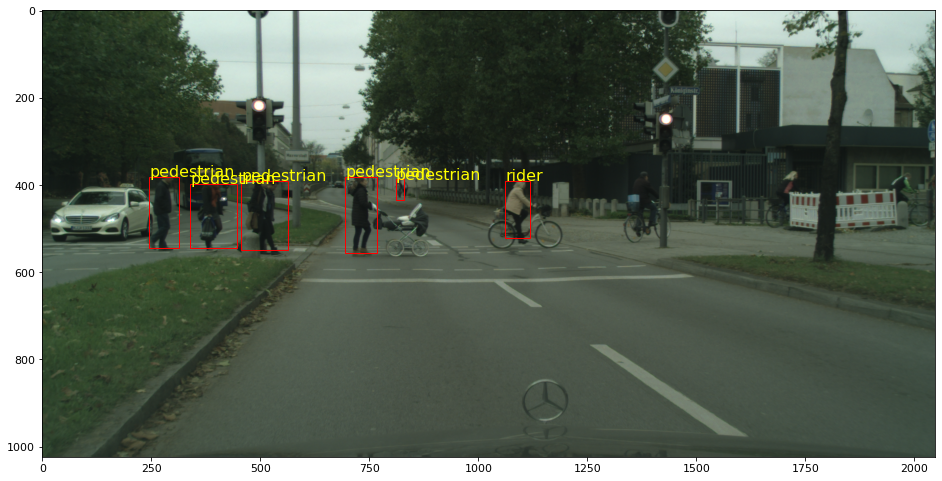

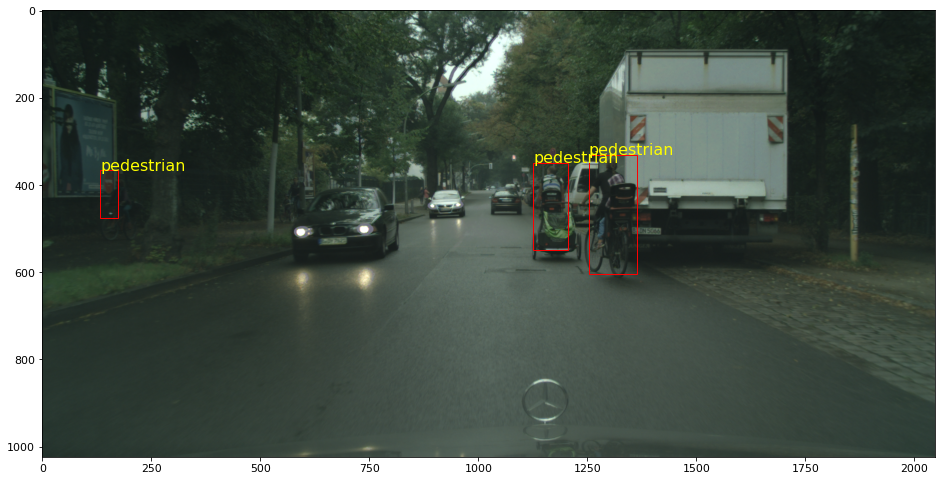

In [ ]:
test_model("frcnn3b")

### 4: Faster RCNN MobileNet v3 Large FPN

- Learning Rate: 0.002
- Weight Decay: 0.002
- Time to Train: ~ 43 min, 47 sec
- Saved Model Name: frcnn4 (default weights), frcnn4b (without default weights)
- Number of Parameters: 100

In [ ]:
model, _ = model_chooser("frcnn4")
print(model)
print(f"Number of Parameters: {len(list(model.parameters()))}")

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block):

#### With Default Weights

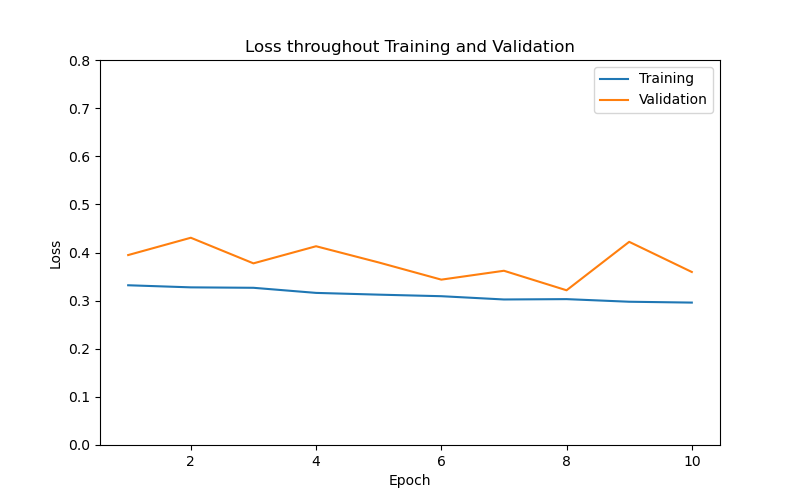

In [ ]:
display(Image.open(project_path + "frcnn4_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   472.995  375.244   547.716  559.522      0.994467        1  pedestrian
  1   242.634  366.439   314.984  546.931      0.993362        1  pedestrian
  2   692.84   370.72    768.551  558.791      0.992604        1  pedestrian
  3   356.267  372.145   423.642  536.635      0.929863        1  pedestrian
  4  1351.81   367.685  1408.67   506.875      0.925942        2  rider
  5  1689.32   365.694  1741.55   494.839      0.803257        1  pedestrian
  6  1063.41   378.539  1124.37   526.125      0.790537        2  rider
  7  1947.57   370.765  1998.01   492.647      0.67928         1  pedestrian 

Test Image Filename: bielefeld_000000_037422_leftImg8bit.png
        xmin     ymin     xmax     ymax    confidence    class  label
---  -------  -------  -------  -------  ------------ 

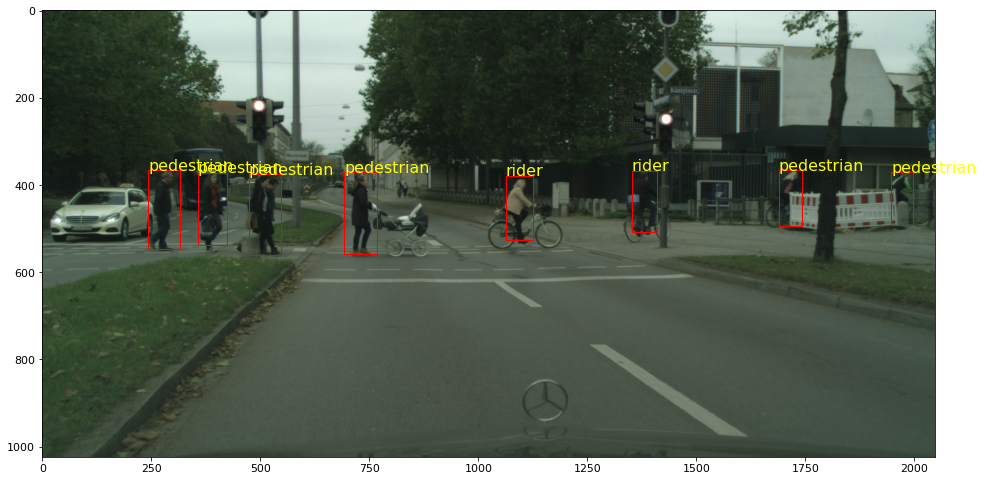

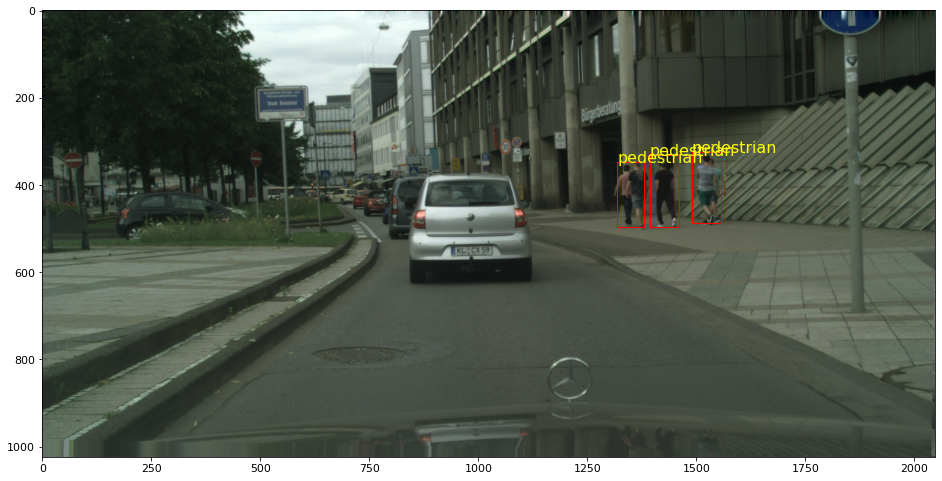

In [ ]:
test_model("frcnn4")

#### Without Default Weights

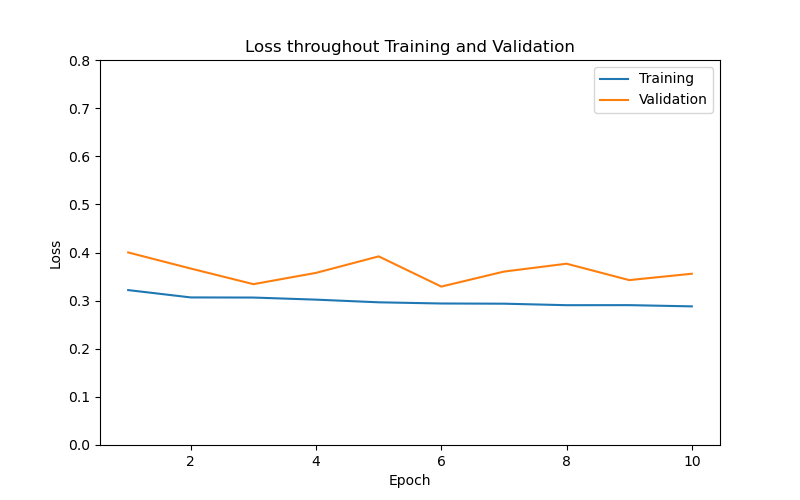

In [ ]:
display(Image.open(project_path + "frcnn4b_loss.png"))

Test Image Filename: munich_000334_000019_leftImg8bit.png
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0   475.756  373.997   550.273  556.588      0.986706        1  pedestrian
  1   694.836  371.619   772.749  559.371      0.985877        1  pedestrian
  2   238.266  362.131   314.874  548.184      0.970836        1  pedestrian
  3  1354.5    369.97   1412.52   509.187      0.959447        2  rider
  4  1062.97   384.168  1123.54   530.301      0.931804        2  rider
  5   361.48   376.742   424.532  528.042      0.73729         1  pedestrian
  6  1682.7    374.685  1729.69   483.445      0.691684        1  pedestrian 



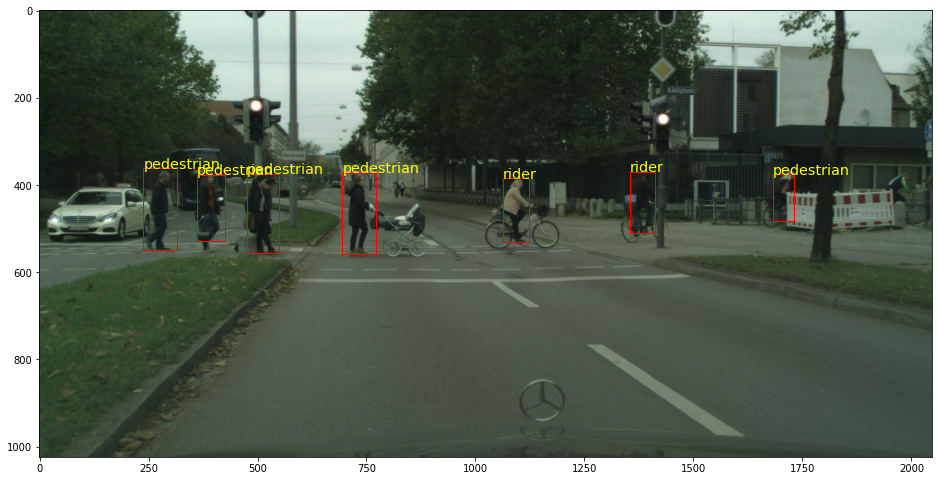

Test Image Filename: berlin_000348_000019_leftImg8bit.png
          xmin     ymin      xmax     ymax    confidence    class  label
---  ---------  -------  --------  -------  ------------  -------  ----------
  0   527.548   416.788   564.49   501.186      0.868735        1  pedestrian
  1  1682.72    375.78   1741.8    517.856      0.862151        1  pedestrian
  2  1638.24    365.2    1705.42   527.309      0.827168        1  pedestrian
  3   572.223   422.62    605.842  505.908      0.814598        1  pedestrian
  4   602.678   421.648   650.281  524.281      0.803156        1  pedestrian
  5  1725.7     382.154  1770.92   489.49       0.782768        1  pedestrian
  6    56.9133  422.846   122.436  580.045      0.709415        1  pedestrian
  7  1776.8     321.161  1914.34   642.693      0.67362         1  pedestrian
  8  1176.01    442.279  1204.09   509.798      0.669559        1  pedestrian
  9  1606.43    363.335  1669.84   515.794      0.665764        1  pedestrian 



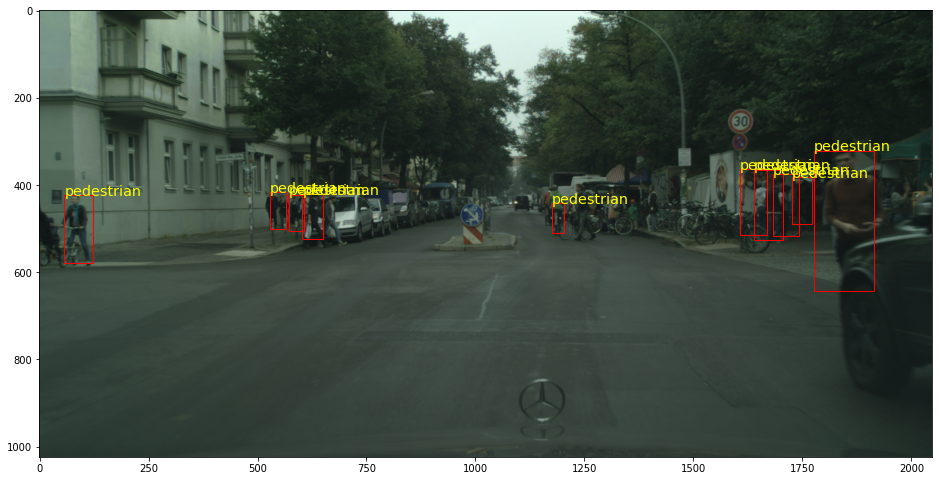

In [ ]:
test_model("frcnn4b")

## Discussion

### Evaluating YOLOv5 against the Labelled Test Data

The following code evaluates the accuracy of the YOLOv5 model against the labelled test data that we manually separated. This is useful for comparing with the other custom-trained models we explored in the previous section.

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
model.classes = [0] # 0 = person, according to the COCO format used by the yolov5 model
model.conf = 0.66 # confidence level threshold
ratio_list = []
timer_list = []
missr_list = []

for f in glob.glob(image_path + "test" + "/*/*.png"):
    p_boxes = [] # predicted boxes
    l_boxes = [] # labelled boxes

    # Get Label Boxes
    label_fpath = f.replace("Cityshapes_images/leftImg8bit", "CityPersons_labels/gtBboxCityPersons").replace(image_ends, label_ends)
    with open(label_fpath) as file:
        label = json.load(file)
    for l in label["objects"]:
        if l["label"] in ["pedestrian", "rider"]:
            a, b, c, d = l["bbox"][0], l["bbox"][1], l["bbox"][0]+l["bbox"][2], l["bbox"][1]+l["bbox"][3]
            l_boxes.append(Polygon([(a,b), (a,d), (c,d), (c,b)]))

    # Get Predicted Boxes
    start_time = time.time()
    image = Image.open(f)
    results = model(image)
    r = results.pandas().xyxy[0]
    for i in r.index:
        p_boxes.append(Polygon([
            (r['xmin'][i], r['ymin'][i]),
            (r['xmin'][i], r['ymax'][i]),
            (r['xmax'][i], r['ymax'][i]),
            (r['xmax'][i], r['ymin'][i]),
        ]))
    end_time = time.time()

    tp, fp, fn = 0, 0, 0
    if len(p_boxes) == 0 and len(l_boxes) == 0:
        ratio = 1 # If there are no labels, and the model correctly returns no labels.
        miss_rate = 0
    elif len(p_boxes) > 0 and len(l_boxes) == 0:
        ratio = 0 # 100% incorrect.
        miss_rate = 0
        fp += len(p_boxes)
    elif len(p_boxes) == 0 and len(l_boxes) > 0:
        ratio = 0
        miss_rate = 1
    else:
        # Calculate % Overlap (Accuracy)
        pred_boxes = gpd.GeoDataFrame(geometry=p_boxes)
        labelled_boxes = gpd.GeoDataFrame(geometry=l_boxes)
        intersect = pred_boxes.overlay(labelled_boxes, how='intersection')
        union = pred_boxes.overlay(labelled_boxes, how='union')
        common_areas = intersect.geometry.area
        total_areas = union.geometry.area
        ratio = sum(common_areas) / sum(total_areas)

        # Calculate Miss Rate, IOU threshold = 0.5
        l_marks = [(l,False) for l in l_boxes] # Polygon types are unhashable :(
        for p in p_boxes:
            o = dict()
            for l in [x[0] for x in l_marks if not x[1]]: # only look at unmarked Ls
                o[p.intersection(l).area / p.union(l).area] = l
            if not o: # If no overlapping labels at all, false positive
                fp += 1
                continue
            l = o[max(o.keys())]
            l_marks[l_marks.index((l,False))] = (l,True) # mark this L
            if l.intersection(p).area / l.union(p).area >= 0.5:
                tp += 1
            else:
                fp += 1
        fn += len([x for x in l_marks if not x[1]])
        try:
            miss_rate = fn / (tp + fn)
        except:
            miss_rate = -1

    if miss_rate >= 0:
        missr_list.append(miss_rate * 100)
    ratio_list.append(ratio*100)
    timer_list.append((end_time - start_time) * 1000)

print(f"avg_overlap: {round(sum(ratio_list)/len(ratio_list), 2)}%")
print(f"avg_miss_rate_pc: {round(sum(missr_list)/len(missr_list), 2)}%")
print(f"avg_ms_per_image: {round(sum(timer_list)/len(timer_list), 2)}ms")

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-11-16 Python-3.7.15 torch-1.12.1+cu113 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


avg_overlap: 43.21%
avg_ms_per_image: 455.82ms


For a fair comparison with each of the trained models (which were exclusively evaluated locally due to computational demands), this code was also run locally and produced the following outputs, which can be compared to the later other results:

```
avg_overlap_pc: 43.21%
avg_miss_rate_pc: 62.79%
avg_ms_per_image: 61.37ms
```


### Evaluating the Models against the Labelled Test Data

The code below takes all of the models explored in the previous section and calculates their accuracies by using the 233 labelled test images we allocated for this purpose. We compare the bounding boxes of the prediction with the bounding boxes expressed in the given labels, and determine the percentage of overlap by calculating `Intersection / Union`. 
  
Using that we can calculate the average miss rate. Each prediction box is counted as a true positive, if the intersection over union is larger than 0.5 with a labelled box. If a prediction has no overlap larger than 0.5 with an unmatched labelled box it is counted as a false positive. If there are labelled boxes that have no matching prediced box, these are counted as false negatives. 

From that we can calculate the miss rate like so:

$mr = \frac{fn}{tp+fn} $

Note, the execution time on the Google Colab platform was excessive, so the code was run locally. The results/outputs of are shown below the code.

In [ ]:
# THIS CELL HAS AN EXCESSIVE EXECUTION TIME ON GOOGLE COLAB - DO NOT RUN.

models = ["frcnn1","frcnn1b","frcnn2","frcnn2b","frcnn3","frcnn3b","frcnn4","frcnn4b"]
#models = ["frcnn1", "frcnn2", "frcnn3", "frcnn4"]
#models = ["frcnn1b", "frcnn2b", "frcnn3b", "frcnn4b"]

stat_list = []
for model_name in models:
    model, _ = model_chooser(model_name)
    model.load_state_dict(torch.load(project_path + f"{model_name}.pth", map_location=device))
    model.to(device)
    model.eval()
    ratio_list = []
    timer_list = []
    missr_list = []

    for f in glob.glob(image_path + "test" + "/*/*.png"):
        p_boxes = [] # predicted boxes
        l_boxes = [] # labelled boxes

        # Get Label Boxes
        label_fpath = f.replace("Cityshapes_images/leftImg8bit", "CityPersons_labels/gtBboxCityPersons").replace(image_ends, label_ends)
        with open(label_fpath) as file:
            label = json.load(file)
        for l in label["objects"]:
            if l["label"] in ["pedestrian", "rider"]:
                a, b, c, d = l["bbox"][0], l["bbox"][1], l["bbox"][0]+l["bbox"][2], l["bbox"][1]+l["bbox"][3]
                l_boxes.append(Polygon([(a,b), (a,d), (c,d), (c,b)]))

        # Get Predicted Boxes
        start_time = time.time()
        image = Image.open(f).convert("RGB")
        transform = transforms.Compose([transforms.ToTensor()])
        image = transform(image).to(device)
        with torch.no_grad():
            p = model([image])
            for j, bbox in enumerate(p[0]["boxes"]):
                a, b, c, d = bbox[0].item(), bbox[1].item(), bbox[2].item(), bbox[3].item()
                if p[0]["scores"][j] > 0.66:
                    p_boxes.append(Polygon([(a,b), (a,d), (c,d), (c,b)]))
        end_time = time.time()
        
        tp, fp, fn = 0, 0, 0
        if len(p_boxes) == 0 and len(l_boxes) == 0:
            ratio = 1 # If there are no labels, and the model correctly returns no labels.
            miss_rate = 0
        elif len(p_boxes) > 0 and len(l_boxes) == 0:
            ratio = 0 # 100% incorrect.
            miss_rate = 0
        elif len(p_boxes) == 0 and len(l_boxes) > 0:
            ratio = 0
            miss_rate = 1
        else:
            # Calculate % Overlap (Accuracy)
            pred_boxes = gpd.GeoDataFrame(geometry=p_boxes)
            labelled_boxes = gpd.GeoDataFrame(geometry=l_boxes)
            intersect = pred_boxes.overlay(labelled_boxes, how='intersection')
            union = pred_boxes.overlay(labelled_boxes, how='union')
            common_areas = intersect.geometry.area
            total_areas = union.geometry.area
            ratio = sum(common_areas) / sum(total_areas)

            # Calculate Miss Rate, IOU threshold = 0.5
            l_marks = [(l,False) for l in l_boxes] # Polygon types are unhashable :(
            for p in p_boxes:
                o = dict()
                for l in [x[0] for x in l_marks if not x[1]]: # only look at unmarked Ls
                    o[p.intersection(l).area / p.union(l).area] = l
                if not o: # If no overlapping labels at all, false positive
                    fp += 1
                    continue
                l = o[max(o.keys())]
                l_marks[l_marks.index((l,False))] = (l,True) # mark this L
                if l.intersection(p).area / l.union(p).area >= 0.5:
                    tp += 1
                else:
                    fp += 1
            fn += len([x for x in l_marks if not x[1]])
            try:
                miss_rate = fn / (tp + fn)
            except:
                miss_rate = -1

        if miss_rate >= 0:
            missr_list.append(miss_rate * 100)
        overlap = ratio * 100
        speed = (end_time - start_time) * 1000
        ratio_list.append(overlap)
        timer_list.append(speed)

    stat_list.append({"name":model_name,
                      "avg_overlap_pc":round(sum(ratio_list)/len(ratio_list), 2),
                      "avg_miss_rate_pc":round(sum(missr_list)/len(missr_list), 2),
                      "avg_ms_per_image":round(sum(timer_list)/len(timer_list), 2),
                    })

for e in stat_list: print(e)

# Take stats from previous cell and put here
plot_yolo = True
yolo_overlap = 43.21
yolo_mr = 62.79
yolo_speed = 61.37

colours = ["royalblue"] * len(models)
overlap_bars = [e["avg_overlap_pc"] for e in stat_list]
speed_bars = [e["avg_ms_per_image"] for e in stat_list]
mr_bars = [e["avg_miss_rate_pc"] for e in stat_list]

if plot_yolo:
    models.append("yolov5")
    overlap_bars.append(yolo_overlap)
    speed_bars.append(yolo_speed)
    mr_bars.append(yolo_mr)
    colours.append("lightskyblue")

# Overlap Plot
plt.figure(figsize=(7,5))
plt.ylim(0,100)
plt.bar(models, overlap_bars, color=colours, width=0.5)
plt.minorticks_on()
plt.grid(True, which="both", axis='y', linestyle="--", linewidth=0.5)
for i in range(len(models)):
    plt.annotate(str(overlap_bars[i]), xy=(models[i], overlap_bars[i]), ha='center', va='bottom')
plt.title("Comparison of Accuracies (by Overlap)")
plt.ylabel("Average % Overlap with Label")
plt.xlabel("Model")
plt.savefig("eval_overlap.png", format='png')

# Miss Rate Plot
plt.figure(figsize=(7,5))
plt.ylim(0,100)
plt.bar(models, mr_bars, color=colours, width=0.5)
plt.minorticks_on()
plt.grid(True, which="both", axis='y', linestyle="--", linewidth=0.5)
for i in range(len(models)):
    plt.annotate(str(mr_bars[i]), xy=(models[i], mr_bars[i]), ha='center', va='bottom')
plt.title("Comparison of Miss Rates")
plt.ylabel("Average % Miss Rate")
plt.xlabel("Model")
plt.savefig("eval_miss_rate.png", format='png')

# Speed Plot
plt.figure(figsize=(7,5))
plt.bar(models, speed_bars, color=colours, width=0.5)
plt.minorticks_on()
plt.grid(True, which="both", axis='y', linestyle="--", linewidth=0.5)
for i in range(len(models)):
    plt.annotate(str(speed_bars[i]), xy=(models[i], speed_bars[i]), ha='center', va='bottom')
plt.title("Comparison of Inference Speeds")
plt.ylabel("Average Speed per Image (ms)")
plt.xlabel("Model")
plt.savefig("eval_speed.png", format='png')

#### Models with Default Weights

The results of the above code when run locally are shown here. The two graphs that follow show, in order, a comparison between each model for average overlap accuracy, and average speed.
```
{'name': 'frcnn1', 'avg_overlap_pc': 58.9, 'avg_miss_rate_pc': 43.67, 'avg_ms_per_image': 142.37}
{'name': 'frcnn2', 'avg_overlap_pc': 71.03, 'avg_miss_rate_pc': 18.98, 'avg_ms_per_image': 178.82}
{'name': 'frcnn3', 'avg_overlap_pc': 73.4, 'avg_miss_rate_pc': 11.0, 'avg_ms_per_image': 227.76}
{'name': 'frcnn4', 'avg_overlap_pc': 54.75, 'avg_miss_rate_pc': 50.06, 'avg_ms_per_image': 98.63}
```

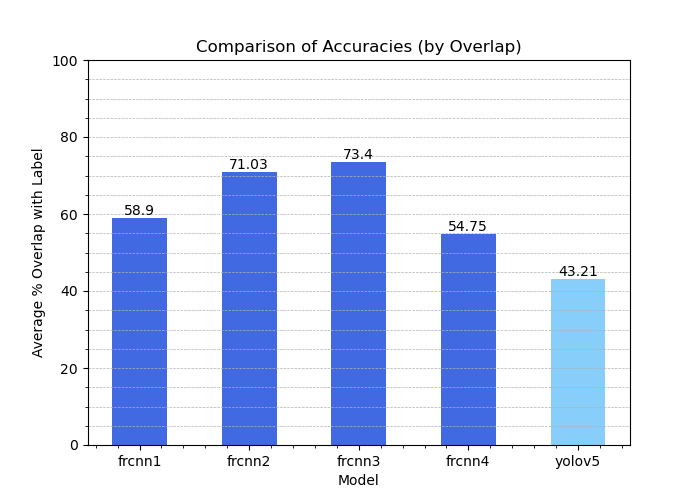

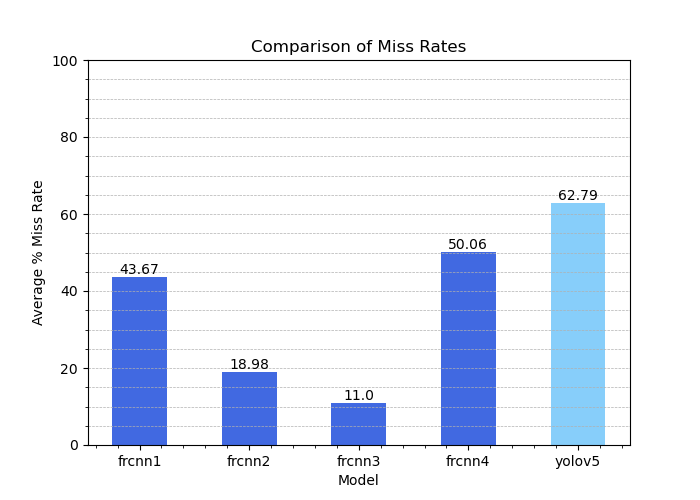

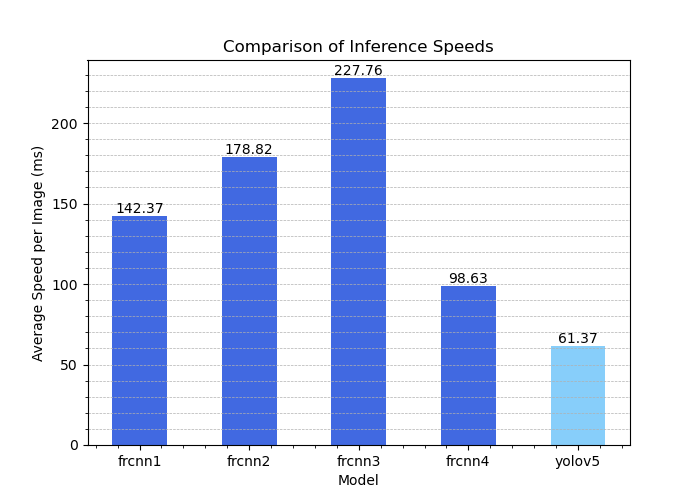

In [ ]:
display(Image.open(project_path + "eval_overlap.png"))
display(Image.open(project_path + "eval_miss_rate.png"))
display(Image.open(project_path + "eval_speed.png"))

#### Models without Default Weights

The results of the above code (modified to evaluate the 'b' models) when run locally are shown here. The two graphs that follow show, in order, a comparison between each model for average overlap accuracy, and average speed.
```
{'name': 'frcnn1b', 'avg_overlap_pc': 41.55, 'avg_miss_rate_pc': 60.0, 'avg_ms_per_image': 146.11}
{'name': 'frcnn2b', 'avg_overlap_pc': 68.02, 'avg_miss_rate_pc': 21.66, 'avg_ms_per_image': 179.05}
{'name': 'frcnn3b', 'avg_overlap_pc': 46.31, 'avg_miss_rate_pc': 43.1, 'avg_ms_per_image': 230.47}
{'name': 'frcnn4b', 'avg_overlap_pc': 51.32, 'avg_miss_rate_pc': 55.08, 'avg_ms_per_image': 95.98}
```

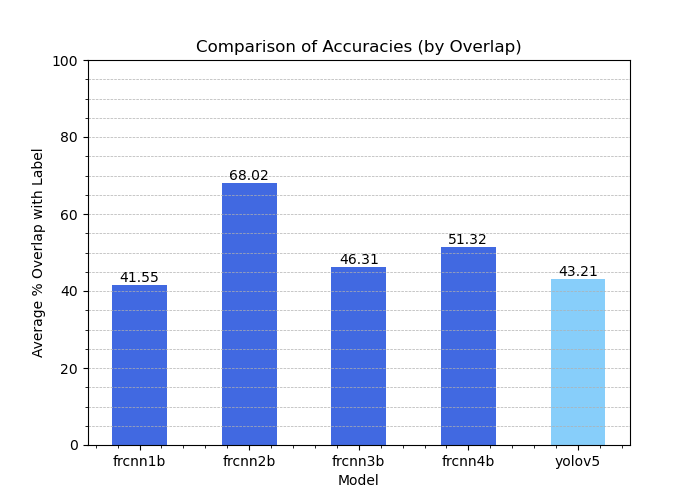

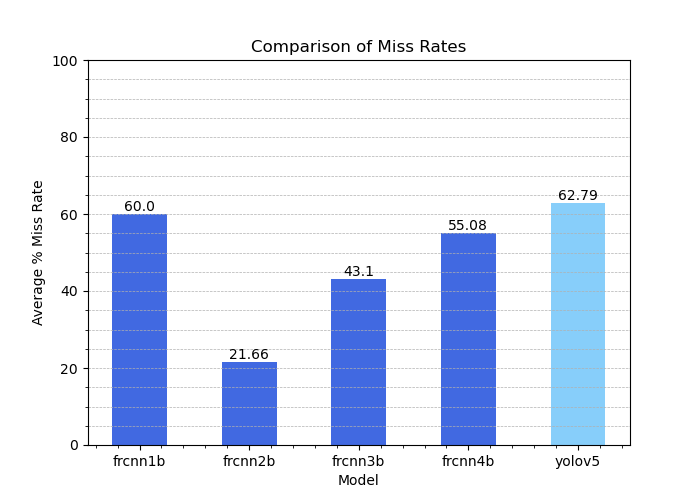

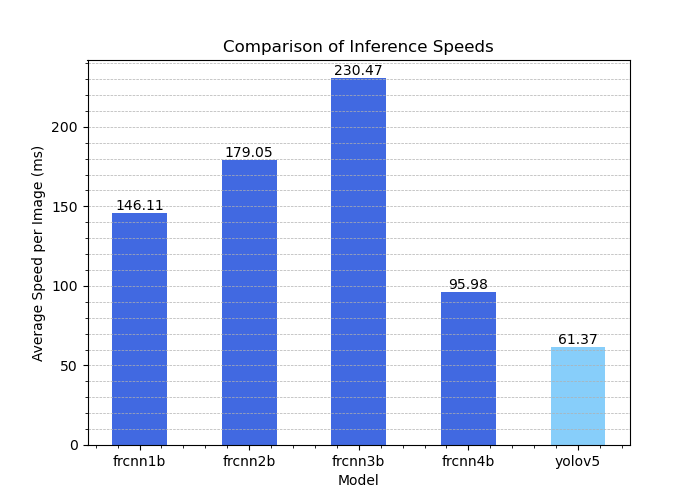

In [ ]:
display(Image.open(project_path + "eval_overlap_b.png"))
display(Image.open(project_path + "eval_miss_rate_b.png"))
display(Image.open(project_path + "eval_speed_b.png"))

### Visual Comparisons on Randomly Selected Unlabelled Images

Based on the above code, we can visualise each model's inference on a randomly selected unlabelled test image for visual comparison. (The cell can be re-run to evaluate against different images).

In [ ]:
def visualise_inferences(model_list):
    chosen_image = random.choice(glob.glob(image_path + "unlabelled_test" + "/*/*.png"))
    for model_name in model_list:
        model, _ = model_chooser(model_name)
        model.load_state_dict(torch.load(project_path + f"{model_name}.pth", map_location=device))
        model.to(device)
        model.eval()

        image = Image.open(chosen_image).convert("RGB")
        transform = transforms.Compose([transforms.ToTensor()])
        image = transform(image).to(device)
        
        with torch.no_grad():
            p = model([image])
            im = mpimg.imread(chosen_image)
            fig, ax = plt.subplots(figsize=(16,9))
            ax.imshow(im)
            table_data = []
            for i, bbox in enumerate(p[0]["boxes"]):
                a, b, c, d = bbox[0].item(), bbox[1].item(), bbox[2].item(), bbox[3].item()
                if p[0]["scores"][i] > 0.66:
                    rect = patches.Rectangle((a, b), c-a, d-b, linewidth=1, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)
                    cls = p[0]["labels"][i].item()
                    ax.text(a, b, class_label(cls), color='yellow', fontsize='x-large')
                    table_data.append([i, a, b, c, d, p[0]['scores'][i].item(), cls, class_label(cls)])
            print(f"MODEL NAME: {model_name}")
            print(tabulate(table_data, headers=[" ", "xmin", "ymin", "xmax", "ymax", "confidence", "class", "label"]), "\n")
            plt.show()
            print("\n")

#### Models with Default Weights

MODEL NAME: frcnn1
        xmin     ymin     xmax     ymax    confidence    class  label
---  -------  -------  -------  -------  ------------  -------  ----------
  0  1601.94  363.677  1680.17  542.985      0.993897        1  pedestrian
  1  1309.1   330.313  1421.01  595.471      0.982367        2  rider
  2  1457.84  371.91   1530.62  536.882      0.940764        1  pedestrian
  3  1185.76  355.975  1257.36  535.443      0.917319        2  rider
  4  1680.62  373.177  1763.52  558.697      0.911107        1  pedestrian
  5  1723.91  379.462  1792.77  546.844      0.869203        1  pedestrian
  6  1031.42  368.181  1104.43  532.411      0.784266        2  rider
  7  1639.17  367.885  1708.49  544.84       0.773869        1  pedestrian 



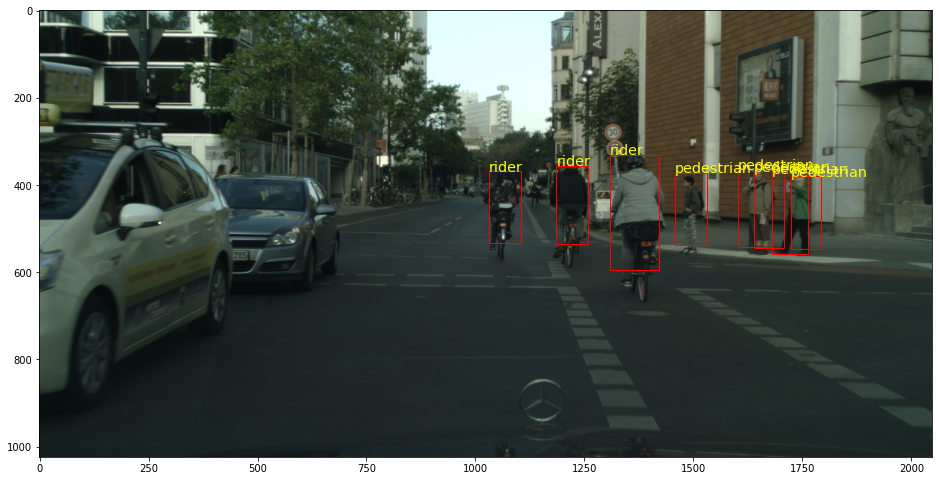



MODEL NAME: frcnn2
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0  1456.73   378.317  1530.17   555.75       0.998829        1  pedestrian
  1  1028.4    357.943  1100.22   533.617      0.998669        2  rider
  2  1610.66   364.003  1689.88   555.586      0.998424        1  pedestrian
  3  1698.61   377.757  1773.5    561.032      0.99776         1  pedestrian
  4  1176.84   343.511  1257.64   545.359      0.99589         2  rider
  5  1312.34   329.287  1425.75   610.771      0.992985        2  rider
  6   432.6    357.569   471.563  452.031      0.985824        1  pedestrian
  7   396.637  353.367   442.953  470.411      0.979348        1  pedestrian
  8   479.787  357.593   512.952  440.604      0.912588        1  pedestrian
  9  1089.04   395.577  1107.95   440.485      0.806404        1  pedestrian
 10   855.941  394.283   872.077  434.529      0.783035        1  pedestria

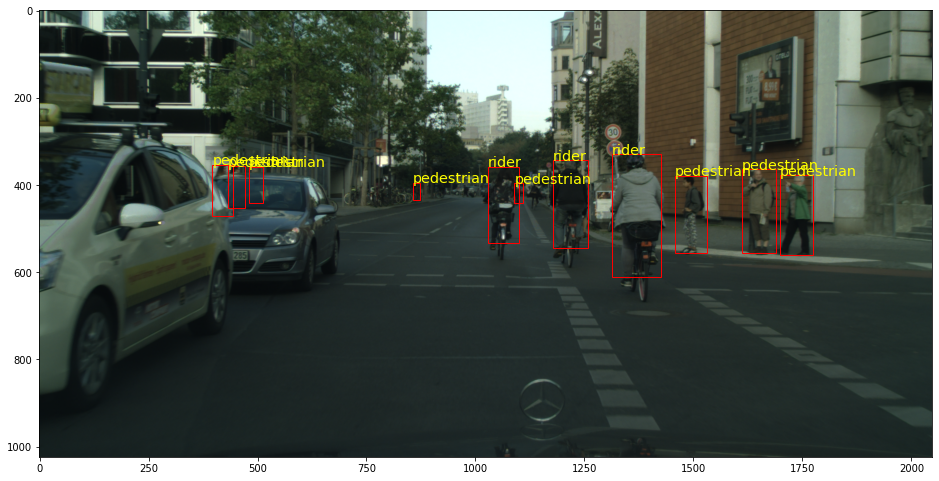



MODEL NAME: frcnn3
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0  1173.53   342.864  1258.72   549.147      0.99598         2  rider
  1  1026.44   365.678  1099.41   540.363      0.994089        2  rider
  2  1612.71   362.896  1690.06   552.818      0.994018        1  pedestrian
  3  1461.38   381.619  1532.95   557.161      0.993445        1  pedestrian
  4  1699.9    375.906  1773.85   558.289      0.992688        1  pedestrian
  5  1316.48   334.738  1436.13   618.666      0.992356        2  rider
  6   429.741  354.528   473.397  475.428      0.946926        1  pedestrian
  7   473.149  357.5     521.371  489.83       0.926996        1  pedestrian
  8   395.162  355.25    446.45   488.479      0.926457        1  pedestrian
  9   973.695  400.653   985.962  430.742      0.893907        1  pedestrian
 10  1124.78   394.71   1153.17   456.478      0.86401         1  pedestria

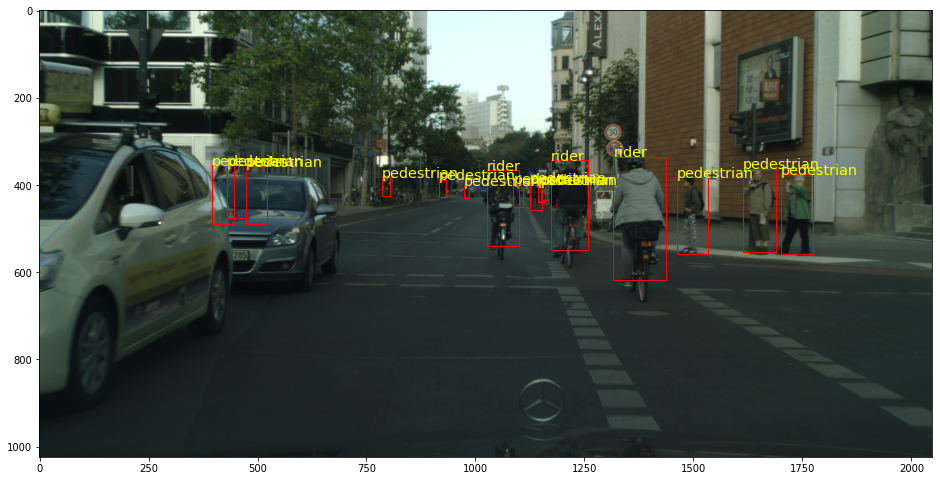



MODEL NAME: frcnn4
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0  1606.11   354.426  1686.89   554.54       0.995478        1  pedestrian
  1  1454.87   373.387  1527.19   556.199      0.982714        1  pedestrian
  2  1305.9    325.107  1426.96   609.199      0.930589        2  rider
  3  1168.36   337.401  1263.84   565.774      0.788691        1  pedestrian
  4   401.678  339.173   468.231  506.145      0.787459        1  pedestrian
  5  1027.2    360.109  1098.23   531.418      0.747294        2  rider
  6  1697.48   350.932  1775.04   558.533      0.684063        1  pedestrian 



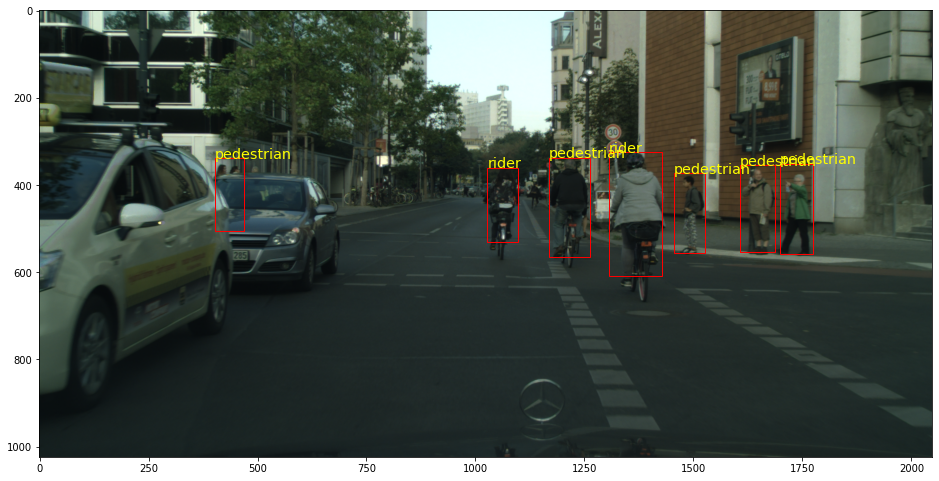

In [ ]:
visualise_inferences(["frcnn1", "frcnn2", "frcnn3", "frcnn4"])

#### Models without Default Weights

MODEL NAME: frcnn1b
         xmin     ymin      xmax     ymax    confidence    class  label
---  --------  -------  --------  -------  ------------  -------  ----------
  0  1815.55   310.743  1940.73   622.102      0.908943        1  pedestrian
  1  1681.9    337.265  1769.24   550.004      0.901305        1  pedestrian
  2   566.212  386.88    619.502  524.479      0.898879        1  pedestrian
  3  1555.96   361.132  1616.77   521.449      0.896096        1  pedestrian
  4  1999.74   342.091  2046.27   531.196      0.895323        1  pedestrian
  5  1074.07   366.536  1152.98   558.691      0.892941        1  pedestrian
  6   183.637  314.801   320.963  673.455      0.890727        1  pedestrian
  7  1196.73   379.383  1246.83   496.182      0.865409        1  pedestrian
  8   368.013  357.681   463.457  593.03       0.859775        1  pedestrian
  9   530.078  405.233   576.873  518.996      0.837974        1  pedestrian
 10   556.266  401.826   601.054  521.984      0.829977      

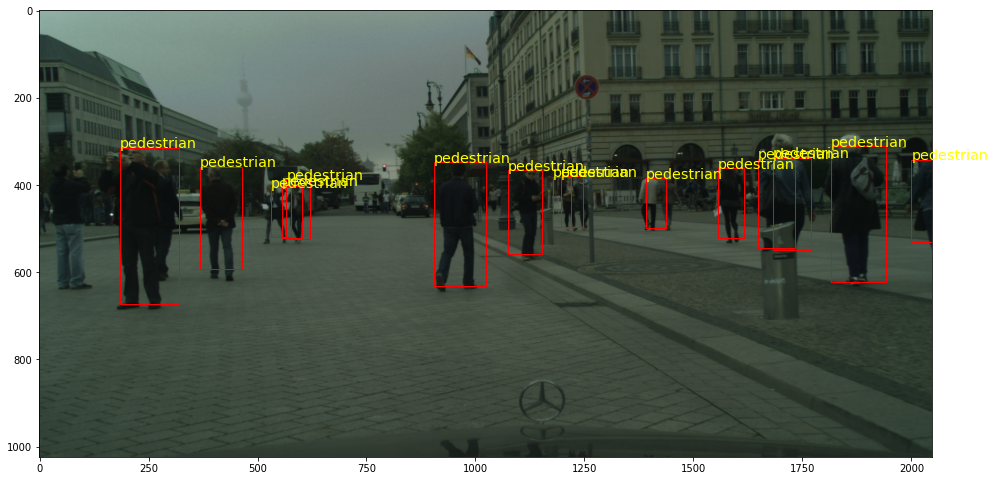

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

MODEL NAME: frcnn2b
           xmin     ymin       xmax     ymax    confidence    class  label
---  ----------  -------  ---------  -------  ------------  -------  ----------
  0   357.662    358.045   462.337   615.381      0.9991          1  pedestrian
  1  1080.2      358.302  1169.46    570.052      0.999064        1  pedestrian
  2  1793.91     287.906  1938.36    637.86       0.998161        1  pedestrian
  3  1372.88     365.999  1433.55    508.418      0.99786         1  pedestrian
  4  1550.33     352.186  1621.42    536.817      0.997747        1  pedestrian
  5     7.93076  353.103   126.556   639.911      0.997205        1  pedestrian
  6   158.584    320.873   310.292   684.274      0.99708         1  pedestrian
  7   899.397    347.259  1021.36    648.621      0.995903        1  pedestrian
  8  1190.38     378.438  1243.56    507.728      0.993303        1  pedestrian
  9   506.399    399.623   562.771   535.694      0.991282        1  pedestrian
 10  1416.57     376.529 

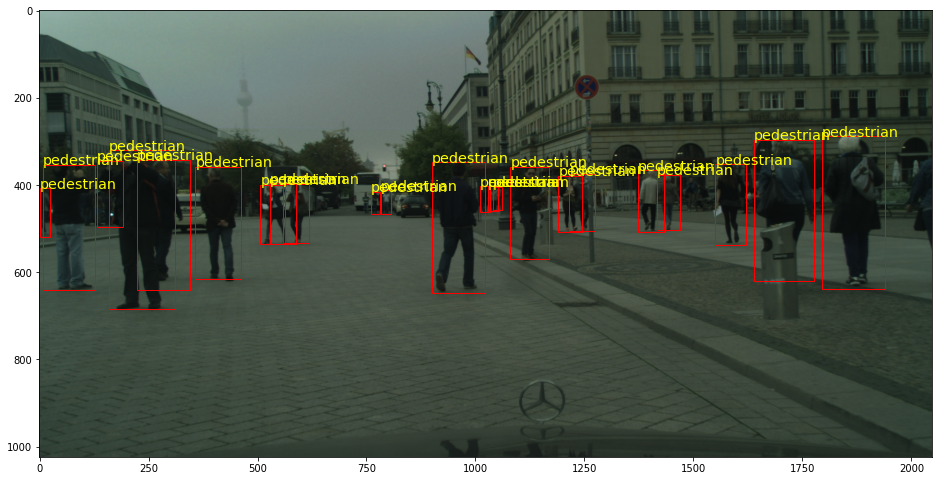



MODEL NAME: frcnn3b
           xmin     ymin      xmax     ymax    confidence    class  label
---  ----------  -------  --------  -------  ------------  -------  ----------
  0     7.05433  327.237   131.322  638.994      0.912546        1  pedestrian
  1  1005.91     403.146  1033.43   471.279      0.906977        1  pedestrian
  2  1080.79     357.425  1166.53   566.843      0.902989        1  pedestrian
  3   506.854    398.786   564.037  538.464      0.902814        1  pedestrian
  4  1029.65     405.291  1054.43   468.038      0.853569        1  pedestrian
  5   356.375    350.764   467.84   623.525      0.831271        1  pedestrian
  6   864.692    356.665  1056.06   623.549      0.786705        1  pedestrian
  7  1184.93     378.907  1239.54   508.433      0.726942        1  pedestrian
  8  1544.3      345.579  1624.96   535.677      0.724433        1  pedestrian
  9  1593.88     344.231  1663.37   521.924      0.706279        1  pedestrian
 10  1805.57     257.859  1946.2   

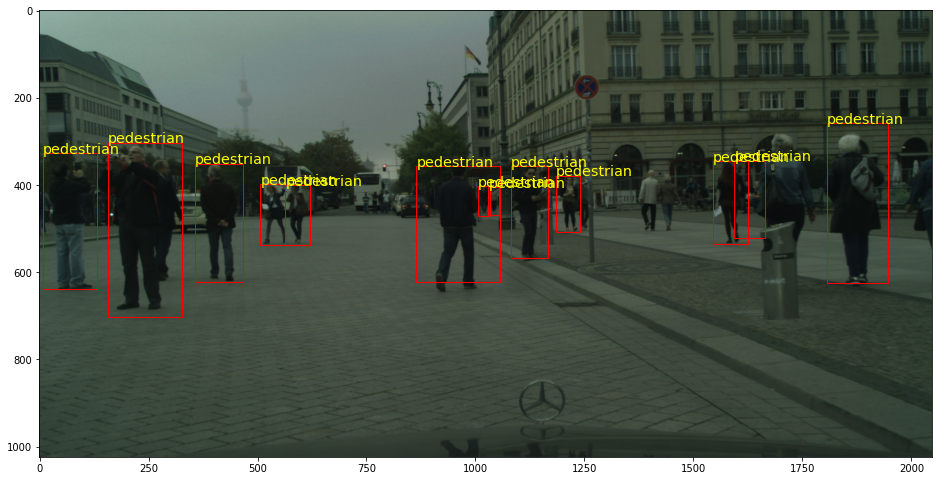



MODEL NAME: frcnn4b
           xmin     ymin      xmax     ymax    confidence    class  label
---  ----------  -------  --------  -------  ------------  -------  ----------
  0  1798.27     287.981  1941.29   623.138      0.995801        1  pedestrian
  1   895.982    329.605  1026.84   638.563      0.994794        1  pedestrian
  2   158.604    302.054   315.111  669.001      0.990674        1  pedestrian
  3  1065.66     330.047  1168.52   573.983      0.989433        1  pedestrian
  4  1543.93     344.872  1619.97   533.089      0.983635        1  pedestrian
  5   563.841    389.315   624.247  536.827      0.972068        1  pedestrian
  6     9.52508  326.151   141.197  641.943      0.971545        1  pedestrian
  7   350.4      335.82    466.4    608.477      0.97071         1  pedestrian
  8  1396.5      380.1    1449.4    508.155      0.955482        1  pedestrian
  9  1640.95     281.768  1773.61   594.746      0.942325        1  pedestrian
 10  1203        371.963  1259.67  

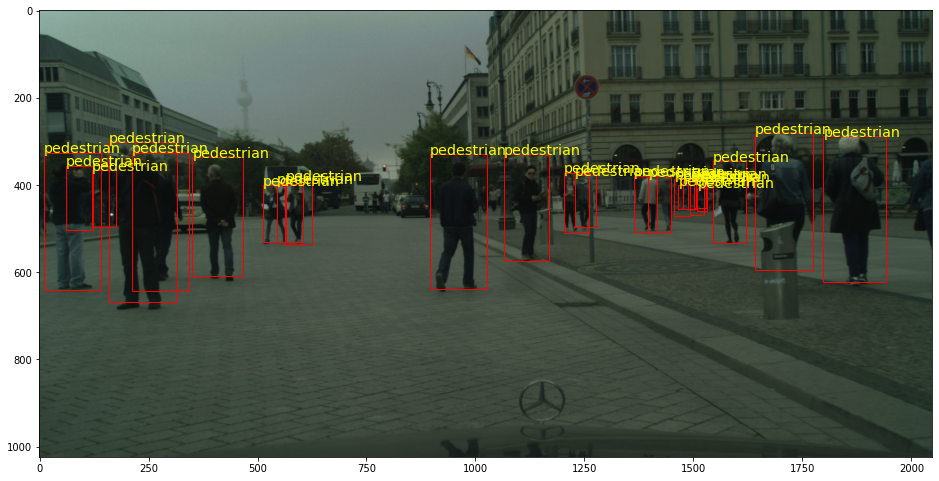

In [ ]:
visualise_inferences(["frcnn1b", "frcnn2b", "frcnn3b", "frcnn4b"])

### Discussions and Conclusions


We can see from the results, that the ResNet50 implementations performed best in terms of accuracy. Our ResNet50v2 has an average overlap of 73% with the ground truth and a miss rate of just 11%, when using an intersection ratio of 50% as the confidence level. For the simpler ResNet50 implementation we were able to achieve a average overlap of 71% at a miss rate of 19%. The MobileNetV3 implementation had an average overlap with the ground truth of around 55%, whereas the MobileNetV2 model acheived 59%. They had a miss rate of 50% and 44% respectively. 

This is because the architecture of the latter two, which uses compressing modules to achieve faster prediction speeds, leads to prediction losses with smaller, lower quality, background parts of the images. The ResNet50 implementations on the other hand were able to make out pedestrians, that would have been hard to detect for a human even when they were in the shade and far im the background and for most parts correctly ignored pictures of humans on advertisements and store windows. 

All four models were able to achieve higher prediction overlap with the ground truth a smaller miss rate than YOLOv5 which had and average overlap with the labelled boxes of 43% and a miss rate of 63%. YOLO was for the most part only able to detect clearly visible large human figures in the foreground of the images. 

In the context of autonomous and/or assisstive driving however, these foreground figures are most important to spot. A pedestrian walking on the sideway far in the distance will only become relevant for a self-driving car, once they enter onto the road and are fairly close to the car. All models were able to spot pedestrians in the foreground accurately and without error. Still, the ability to spot pedestrians early and a better awareness of what is going on further along the road could help improve an autonomous car's optimal path and speed assessment and ability to drive in a more predictable manner for third parties.

Another part of our assessments were time considerations, especially the inference time, i.e. the time it takes the trained model on average to detect the pedestrians in an image. Given how fast a situation can change when driving at even slow speeds, models need to be extremely fast when making detections. A new assessment of the situation must be made multiple times per second. In self-driving cars, many other factors and data from other models and sensors need to be considered for each adjustment to path and speed. This also means that the car's computaional power must be shared between these systems. 

In that regard, all models that performed better in terms of prediction accuracy, performed more poorly in terms of inference speed. Our best implementation concerning accuracy, the ResNet50v2, had an inference time of 228 ms on average. This is with high resolution images on our hardware, that is described at the top. With that inference time, around four frames per second (fps) can be fed into the network. This is almost 50ms or 22% slower than our ResNet50v1 implementation, which has only 2% less overlap or an 8% higher miss rate. The MobileNetV3 implementation was our fastest model, with an inference time on our hardware slightly below 100ms, beating the MobileNetV2 version by 44ms and the faster ResNet50 by 80ms. With an inference time of 100ms, 10 fps from a video frame can be reviewed for pedestrian detection. The simpler YOLOv5 that we tested on the data outperformed even our fastest model with only 61ms inference time on average. 

While Faster-RCNN models are known to be fast, because they are making use of region proposal networks to find interesting regions in the image to classify(compared to selective search algorithms in Fast-RCNN), they are outperformed by single stage detection models like YOLOv5, because these – as the name implies – use only one network to perform the classification and detection task. Compared to a classical classification network only the last layers are changed to convolutional layers to produce the bounding box predictions. This makes them as fast as classifiers, while usually not as accurate as FRCNN models. We could see this in our experiments.


A much smaller consideration in choosing a model fit for our purpose, was the training time. In order to try different implementations and test hyperparamters, a shorter training time is preferable. Once an appropriate model architecture and hyperparameters are found however, training time looses its importance. We did not train YOLOv5 on our data but would assume it would beat our implementations in terms of training time, given its simpler architecture.

## Future Work 

The dataset used only had fairly usual street scenes as part of their images. Accurate detection becomes especially important in cases of unforeseen nature, e.g. a person that has fallen on the street while walking or riding a bicycle. Since there are no such images in the dataset, and these types of images are hard to come by, data augmentation could potentially help increase the models' real world performance. Examples of such augmentation could be a random rotation or even a distortion applied to the original images. 

Another interesting approach that could help with overall situational awareness in self-driving applications would be short-term memory. When the network has detected a person riding a bicycle a couple of frames prior, and now the rider has fallen an the model is not sure what it sees in the same area, an implementation of short-term memory could become useful to increase the detection accuracy especially in the aforementioned unforeseen situations. 

Going back to the quality of the dataset, one main issue we see with all of the data available online for pedestrian detection, is the lack of diversity in the datasets. Most, if not all, datasets used for pedestrian detection are images taken in central European or North American cities. This lack of diversity leads to models learning to recognize mostly pedestrians of European ethnicities. Similarly the general look of streets, buildings and sidewalks will be very different from region to region in other parts of the world. 

While it might be easy enough for the models trained on these datasets to abstract towards more rural scenes, animals and plants encountered in different parts of the world – that could interact with traffic as well or even look similar to a pedestrian – are usually not seen in any of the data. 

Further, datasets usually do not include night-time images and/or bad weather, such as strong rain or snow. All these shortcomings would need to be addressed or corrected for, before an actual real-world application of these models can be considered.

## References

#### Research
- `[1]` Ren, Shaoqing, Kaiming He, Ross B. Girshick and Jian Sun. “Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks.” IEEE Transactions on Pattern Analysis and Machine Intelligence 39 (2015): 1137-1149.  

- `[2]` Li, Yanghao, Saining Xie, Xinlei Chen, Piotr Dollár, Kaiming He and Ross B. Girshick. “Benchmarking Detection Transfer Learning with Vision Transformers.” ArXiv abs/2111.11429 (2021): n. pag.  

- `[3]` Howard, Andrew G., Mark Sandler, Grace Chu, Liang-Chieh Chen, Bo Chen, Mingxing Tan, Weijun Wang, Yukun Zhu, Ruoming Pang, Vijay Vasudevan, Quoc V. Le and Hartwig Adam. “Searching for MobileNetV3.” 2019 IEEE/CVF International Conference on Computer Vision (ICCV) (2019): 1314-1324.  

- `[4]` Sovit Ranjan Rath. “A Simple Pipeline to Train PyTorch Faster RCNN Object Detection Model.” Debugger Cafe, November 29, 2021. https://debuggercafe.com/a-simple-pipeline-to-train-pytorch-faster-rcnn-object-detection-model/.  

- `[5]` Devjyoti Chakraborty. “Training an Object Detector from Scratch in Pytorch.” PyImageSearch, December 4, 2021. https://pyimagesearch.com/2021/11/01/training-an-object-detector-from-scratch-in-pytorch/.  

- `[6]` Yağmur Çiğdem Aktaş. “Object Detection with Convolutional Neural Networks.” Towards Data Science, January 30, 2022. https://towardsdatascience.com/object-detection-with-convolutional-neural-networks-c9d729eedc18.  

- `[7]` Ahmed Fawzy Gad. “Faster R-CNN Explained for Object Detection Tasks.” Paperspace Blog. Paperspace Blog, April 9, 2021. https://blog.paperspace.com/faster-r-cnn-explained-object-detection/.  

- `[8]` Elisha Odemakinde. “Everything about Mask R-CNN: A Beginner's Guide.” viso.ai, July 11, 2022. https://viso.ai/deep-learning/mask-r-cnn/.  

#### Datasets

- `[9]` M. Cordts, M. Omran, S. Ramos, T. Rehfeld, M. Enzweiler, R. Benenson, U. Franke, S. Roth, and B. Schiele, “The Cityscapes Dataset for Semantic Urban Scene Understanding,” in Proc. of the IEEE Conference on Computer Vision and Pattern Recognition (CVPR), 2016.
    - https://www.cityscapes-dataset.com

- `[10]` M. Braun, S. Krebs, F. Flohr and D. M. Gavrila, "EuroCity Persons: A Novel Benchmark for Person Detection in Traffic Scenes," in IEEE Transactions on Pattern Analysis and Machine Intelligence, vol. 41, no. 8, pp. 1844-1861, 1 Aug. 2019, doi: 10.1109/TPAMI.2019.2897684.
    - https://eurocity-dataset.tudelft.nl/

- `[11]` Zhang, Shifeng, Yiliang Xie, Jun Wan, Hansheng Xia, S. Li and Guodong Guo. “WiderPerson: A Diverse Dataset for Dense Pedestrian Detection in the Wild.” IEEE Transactions on Multimedia 22 (2020): 380-393.

- `[12]` N. J. Karthika, Chandran Saravanan. ‘Addressing False Positives in Pedestrian Detection’. International Conference on Electronic Systems and Intelligent Computing (ESIC 2020), 3 2020. https://doi.org/10.1007/978-981-15-7031-5_103.

- `[13]` Zhang, Shanshan, Rodrigo Benenson and Bernt Schiele. “CityPersons: A Diverse Dataset for Pedestrian Detection.” 2017 IEEE Conference on Computer Vision and Pattern Recognition (CVPR) (2017): 4457-4465.

#### Library Documentations
- `[14]` https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html#testing-forward-method-optional

- `[15]` https://pytorch.org/tutorials/beginner/data_loading_tutorial.html  

- `[16]` https://pytorch.org/vision/main/models.html  

- `[17]` https://pytorch.org/vision/main/models/faster_rcnn.html  

- `[18]` https://pytorch.org/vision/main/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn.html  

- `[19]` https://pytorch.org/vision/main/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn_v2.html  

- `[20]` https://pytorch.org/vision/main/models/generated/torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn.html  

- `[21]` https://github.com/ultralytics/yolov5
    - https://docs.ultralytics.com/
    - https://github.com/ultralytics/yolov5/issues/36  